# Plot Sample pairwise correlation

Given a table with sample x KO populated with normalized counts, make interesting plots

## Setup

In [649]:
import os 
import re
import glob
import math
import umap
import numpy as np
import pandas as pd
from time import time
from scipy import stats
from scipy.spatial import distance
from scipy.cluster import hierarchy
from collections import * 
import matplotlib.pyplot as plt
import matplotlib.colors as pltc
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches

In [2]:
os.getcwd()

'/scratch/bgrodner/repo-armbrust-metat-search/other_docker_images/jupyter'

In [3]:
workdir = '/scratch/bgrodner/iron_ko_contigs'
os.chdir(workdir)


In [4]:
os.getcwd()

'/scratch/bgrodner/iron_ko_contigs'

In [5]:
os.listdir()

['config.yaml',
 'sc_run_snakemake.sh',
 'file_table.240107.kofam_filt.csv',
 'file_table.240109.kofam_filt.csv',
 'file_table_new.csv',
 '._file_table.240109.kofam_filt.csv',
 'file_table.test.csv',
 '._file_table.240107.kofam_filt.csv',
 'ko00001.json',
 '._file_table_new.csv',
 'file_table.240114.kofam_filt.csv',
 'metat_search_results',
 '._file_table.csv',
 'file_table.240113.kofam_filt.csv',
 'file_table.240107.kofam_unfilt.csv',
 '._file_table.240108.kofam_filt.csv',
 'kofam_filenames.txt',
 '.etetoolkit',
 'iron_contigs.txt',
 'iron_KOs.txt',
 'file_table.240108.kofam_filt.csv',
 'file_table.csv',
 '._file_table.240107.kofam_unfilt.csv',
 '._plt_KO_contig_counts.png',
 '._file_table.test.csv',
 '._file_table.240113.kofam_filt.csv',
 '._file_table.240114.kofam_filt.csv',
 '.snakemake']

## Load table and inspect

In [640]:
dir_combined = 'metat_search_results/dicts_iron_KO_contig/dicts_contig_count/tables_norm_count/combined'
fn_table_sample_ko_norm_counts = f'{dir_combined}/iron_KOs.txt-table_samples_KOs_norm_count.csv'

table = pd.read_csv(fn_table_sample_ko_norm_counts)
table.shape

(531, 404)

In [641]:
table.columns

Index(['fn_KO', 'fn_sample_counts', 'assembly', 'sample', 'ammendment',
       'timepoint', 'depth', 'size', 'rep', 'K02016',
       ...
       'K22336', 'K14712', 'K23910', 'K15762', 'K07238', 'K00205', 'K13857',
       'K08904', 'K00175', 'K23184'],
      dtype='object', length=404)

In [642]:
table[:3]

,fn_KO,fn_sample_counts,assembly,sample,ammendment,timepoint,depth,size,rep,K02016,...,K22336,K14712,K23910,K15762,K07238,K00205,K13857,K08904,K00175,K23184
0,NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...,D1PA.S06C1_C_600.abundance.tsv,D1PA,S06C1,NaN,600,NaN,NaN,C,568201.706187,...,0.0,0.0,0.0,34350.0,2.936369e+06,0.0,0.0,89310.0,0.0,206841.37605
1,NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...,D1PA.S15C1_C_200.abundance.tsv,D1PA,S15C1,NaN,200,NaN,NaN,C,417555.642714,...,1970.0,0.0,0.0,7880.0,2.861526e+06,1970.0,0.0,29550.0,1970.0,61070.00000
2,NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...,D1PA.S34C1_C_2200.abundance.tsv,D1PA,S34C1,NaN,2200,NaN,NaN,C,528992.352820,...,0.0,0.0,0.0,5282.0,2.665839e+06,15846.0,0.0,23769.0,0.0,64476.52888


## Maually inspect correlations

### Get KO dict

Get dataframe

In [ ]:
ko_fn = "ko00001.json"
database = list()
for _, v in pd.read_json(ko_fn).iterrows():
    d = v["children"]
    cat_1 = d["name"]
    for child_1 in d["children"]:
        cat_2 = child_1["name"] # Module?
        for child_2 in child_1["children"]:
            cat_3 = child_2["name"]
            if "children" in child_2:
                for child_3 in child_2["children"]:
                    cat_4 = child_3["name"]
                    fields = [cat_1, cat_2, cat_3, cat_4]
                    database.append(fields)
df_kegg = pd.DataFrame(database, columns=["Level_A", "Level_B", "Level_C", "Level_D"])
df_kegg.shape


(61993, 4)

In [ ]:
ld = df_kegg['Level_D'].values
ld[:5]

array(['K00844  HK; hexokinase [EC:2.7.1.1]',
       'K12407  GCK; glucokinase [EC:2.7.1.2]',
       'K00845  glk; glucokinase [EC:2.7.1.2]',
       'K25026  glk; glucokinase [EC:2.7.1.2]',
       'K01810  GPI, pgi; glucose-6-phosphate isomerase [EC:5.3.1.9]'],
      dtype=object)

In [ ]:
dict_ko_name = {}
for name in ld:
    ko = re.search(r"^\w+",name)[0]
    dict_ko_name[ko] = name

### Look at correlatinos

K02573  napG; ferredoxin-type protein NapG
K08901  psbQ; photosystem II oxygen-evolving enhancer protein 3
0.7736466228692418
5.169741247153063e-92


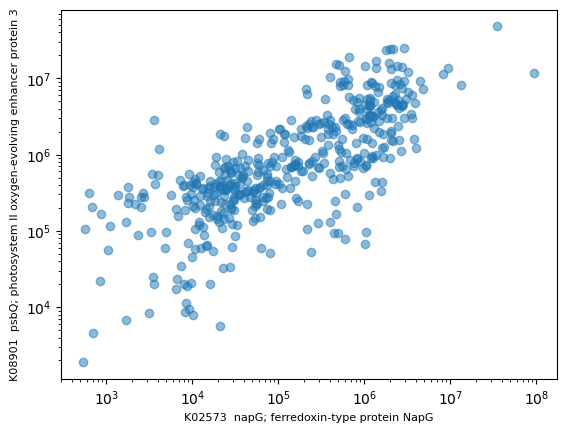

In [623]:
kos_ex = np.random.choice(ko_list, 2, replace=False)



x = dict_ko_samplecounts[kos_ex[0]]
y = dict_ko_samplecounts[kos_ex[1]]

print(dict_ko_name[kos_ex[0]])
print(dict_ko_name[kos_ex[1]])


ci = dict_ko_samplecounts[kos_ex[0]]
cj = dict_ko_samplecounts[kos_ex[1]]
booli = ci.astype(bool)
boolj = cj.astype(bool)
bools = booli*boolj
if sum(bools):
    cib = ci[bools]
    cjb = cj[bools]
    cibl = np.log(cib)
    cjbl = np.log(cjb)
    res = stats.spearmanr(cibl,cjbl)
    stat = res.statistic
    pval = res.pvalue
else:
    stat = 0
    pval = 1

print(stat)
print(pval)

plt.scatter(x,y, alpha=0.5)
plt.xlabel(dict_ko_name[kos_ex[0]], fontsize=8)
plt.ylabel(dict_ko_name[kos_ex[1]], fontsize=8)
plt.xscale('log')
plt.yscale('log')

In [ ]:
stats.spearmanr([0,-1,0,0,0,0,0,0,0,0],[1,2,3,4,5,6,7,8,9,10])

SignificanceResult(statistic=np.float64(0.40618119722996154), pvalue=np.float64(0.2441286818964912))

## Pairwise correlation

Get KOfams as dict

In [213]:
ko_list = table.columns[9:].tolist()
dict_ko_samplecounts = {}
for c in ko_list:
    dict_ko_samplecounts[c] = table[c].values


Get corr coeffs

In [286]:
nkos = len(ko_list)
arr_corr = np.zeros((nkos,nkos,2))
for i, koi in enumerate(ko_list):
    ci = dict_ko_samplecounts[koi]
    booli = ci.astype(bool)
    for j, koj in enumerate(ko_list):
        if i < j:
            cj = dict_ko_samplecounts[koj]
            boolj = cj.astype(bool)
            bools = booli*boolj
            if sum(bools):
                cib = ci[bools]
                cjb = cj[bools]
                cibl = np.log(cib)
                cjbl = np.log(cjb)
                res = stats.spearmanr(cibl,cjbl)
                stat = res.statistic
                pval = res.pvalue
            else:
                stat = 0
                pval = 1
            arr_corr[i,j,:] = [stat, pval]


## Cluster correlations ignoring pvalue

Get both corners of array

In [291]:
arr_cor_nonan = np.nan_to_num(arr_corr)
arr_corr_stat = arr_cor_nonan[:,:,0]
arr_corr_stat_full = arr_corr_stat + np.transpose(arr_corr_stat)

Get linkage

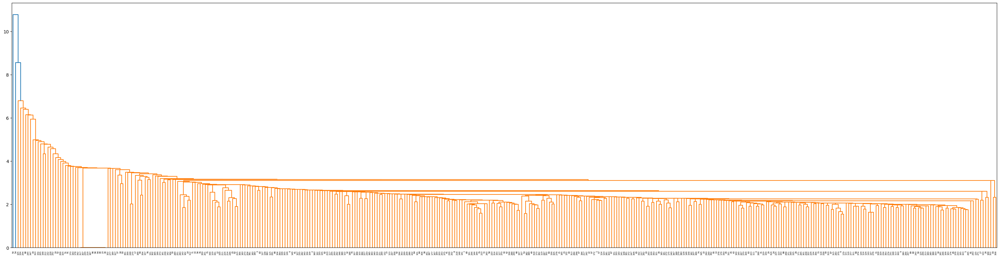

In [309]:
lnk = hierarchy.linkage(arr_corr_stat_full)
fig = plt.figure(figsize=(40,10))
dn = hierarchy.dendrogram(lnk)
plt.show()

Get linkage order

In [293]:
ko_order = hierarchy.leaves_list(lnk)

Reorder matrix rows

In [294]:
dict_idx_row = {i: r for i, r in enumerate(arr_corr_stat_full)}
arr_new = []
for idx in ko_order:
    arr_new.append(dict_idx_row[idx])
arr_new = np.array(arr_new)

Reorder matrix columns

In [295]:
dict_idx_row = {i: r for i, r in enumerate(arr_new.T)}
arr_corr_stat_full_order = []
for idx in ko_order:
    arr_corr_stat_full_order.append(dict_idx_row[idx])
arr_corr_stat_full_order = np.array(arr_corr_stat_full_order)

Plot clustered matrix

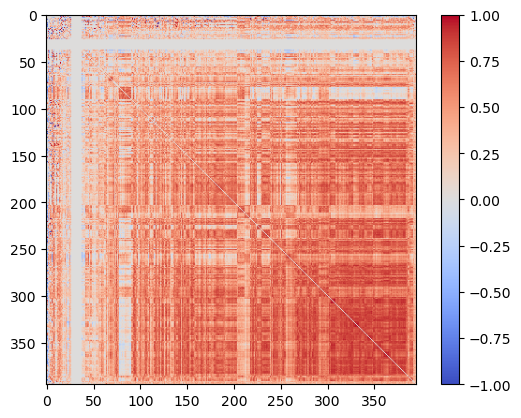

In [296]:
plt.imshow(arr_corr_stat_full_order, cmap='coolwarm')
plt.colorbar()

## Clusters

Pick cutoff distance for clusters

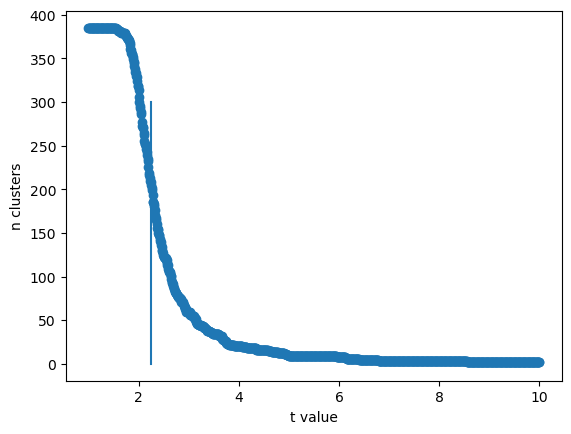

In [501]:
ts = np.linspace(1,10,1000)
nclust = []
for t in ts:
    clusters = hierarchy.fcluster(lnk, t, criterion='distance')
    nclust.append(len(np.unique(clusters)))

plt.scatter(ts, nclust)
plt.ylabel('n clusters')
plt.xlabel('t value')

tselect = 2.25
_ = plt.gca().plot([tselect,tselect],[0,300])

In [502]:
clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
print(len(np.unique(clusters)))



206


Rename clusters in order

In [503]:
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


Map index to KO

In [504]:
dict_idx_koname = {}
for idx, ogidx in enumerate(ko_order):
    ko = ko_list[ogidx]
    koname = dict_ko_name[ko]
    dict_idx_koname[idx] = koname

Plot clusters

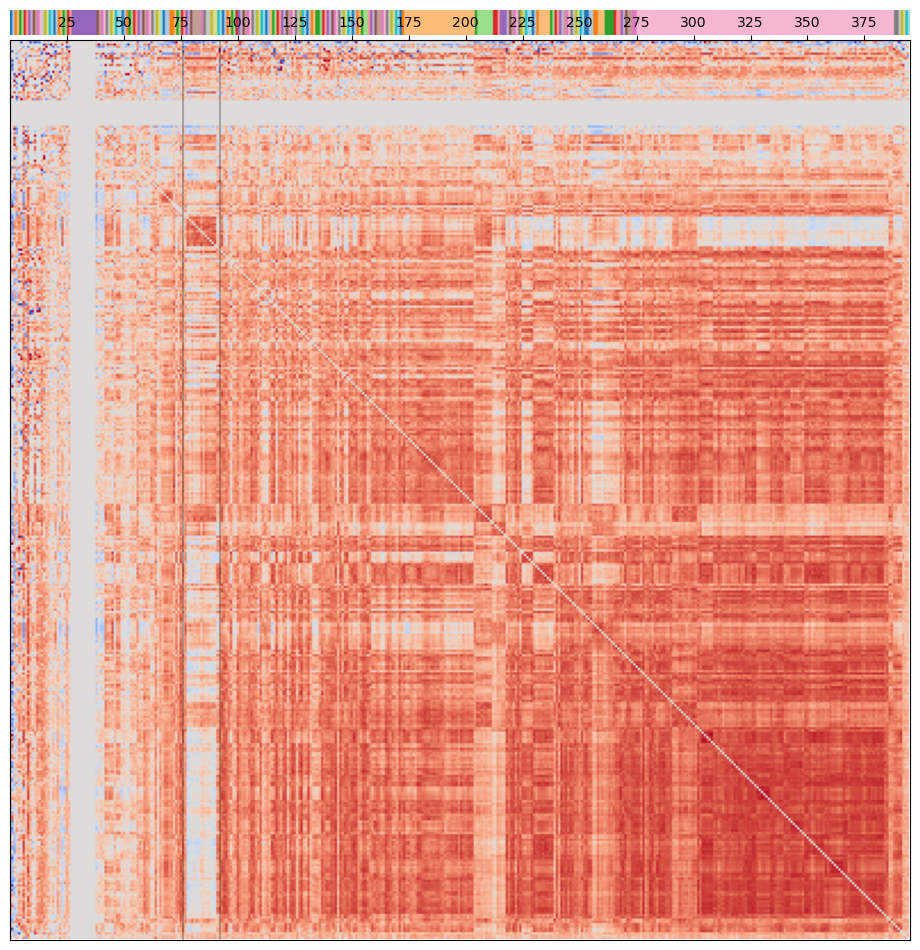

Cluster:: 161	KO: K00374  narI, narV; nitrate reductase gamma subunit [EC:1.7.5.1 1.7.99.-]
Cluster:: 160	KO: K12347  SLC11A1, NRAMP1; natural resistance-associated macrophage protein 1
Cluster:: 29	KO: K21398  SLC11A2, DMT1, NRAMP2; natural resistance-associated macrophage protein 2
Cluster:: 23	KO: K01674  cah; carbonic anhydrase [EC:4.2.1.1]
Cluster:: 22	KO: K16627  SOD3; superoxide dismutase, Cu-Zn family [EC:1.15.1.1]
Cluster:: 22	KO: K14685  SLC40A1, FPN1; solute carrier family 40 (iron-regulated transporter), member 1
Cluster:: 22	KO: K15113  SLC25A28_37, MFRN; solute carrier family 25 (mitochondrial iron transporter), member 28/37
Cluster:: 22	KO: K14713  SLC39A7, KE4, ZIP7; solute carrier family 39 (zinc transporter), member 7
Cluster:: 28	KO: K02641  petH; ferredoxin--NADP+ reductase [EC:1.18.1.2]
Cluster:: 27	KO: K14696  SLC30A9, ZNT9; solute carrier family 30 (zinc transporter), member 9
Cluster:: 24	KO: K16267  zipB; zinc and cadmium transporter
Cluster:: 24	KO: K10534  NR

In [505]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])


idxs = [76,92]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.25)

plt.show()


for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')


New cluster

In [469]:
tselect=2.3

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


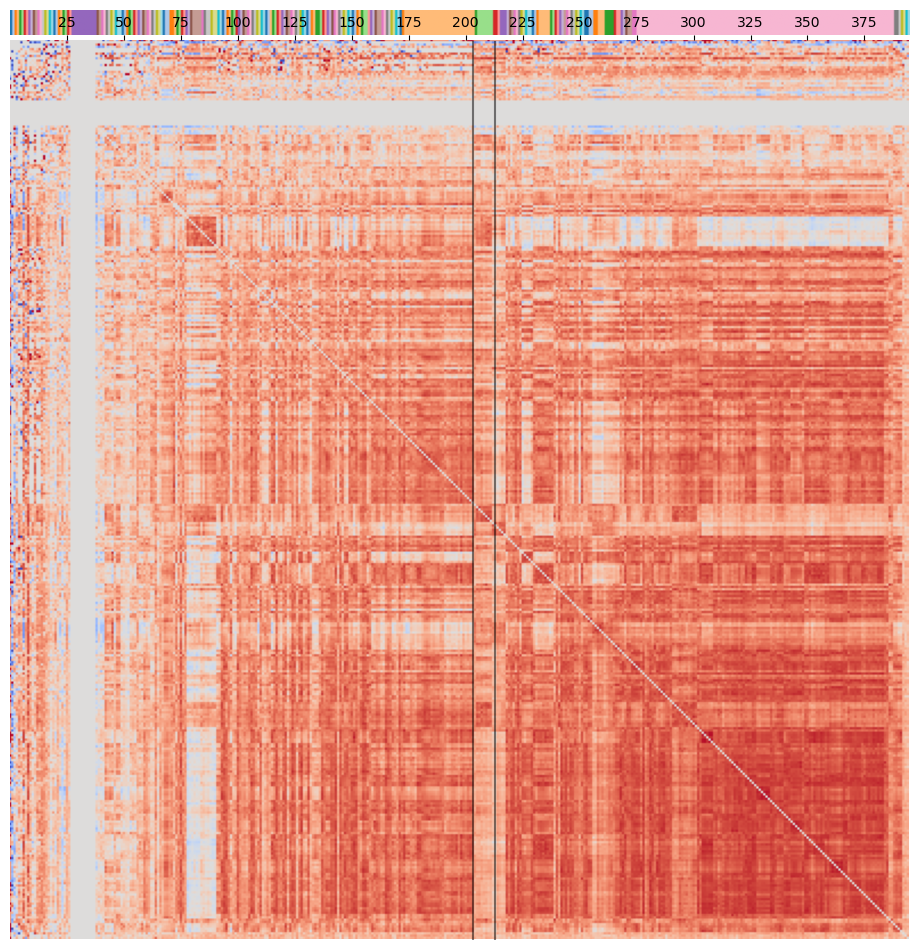

Cluster:: 50	KO: K25284  yclN, ceuB; iron-siderophore transport system permease protein
Cluster:: 60	KO: K04565  SOD1; superoxide dismutase, Cu-Zn family [EC:1.15.1.1]
Cluster:: 59	KO: K00392  sir; sulfite reductase (ferredoxin) [EC:1.8.7.1]
Cluster:: 59	KO: K00366  nirA; ferredoxin-nitrite reductase [EC:1.7.7.1]
Cluster:: 59	KO: K07238  TC.ZIP, zupT, ZRT3, ZIP2; zinc transporter, ZIP family
Cluster:: 59	KO: K25287  desE; iron-desferrioxamine transport system substrate-binding protein
Cluster:: 59	KO: K01086  fbp-SEBP; fructose-1,6-bisphosphatase I / sedoheptulose-1,7-bisphosphatase [EC:3.1.3.11 3.1.3.37]
Cluster:: 59	KO: K03841  FBP, fbp; fructose-1,6-bisphosphatase I [EC:3.1.3.11]
Cluster:: 59	KO: K14709  SLC39A1_2_3, ZIP1_2_3; solute carrier family 39 (zinc transporter), member 1/2/3
Cluster:: 61	KO: K14716  SLC39A10, ZIP10; solute carrier family 39 (zinc transporter), member 10
Cluster:: 61	KO: K14719  SLC39A13, ZIP13; solute carrier family 39 (zinc transporter), member 13


In [499]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [203,213]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2.3

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


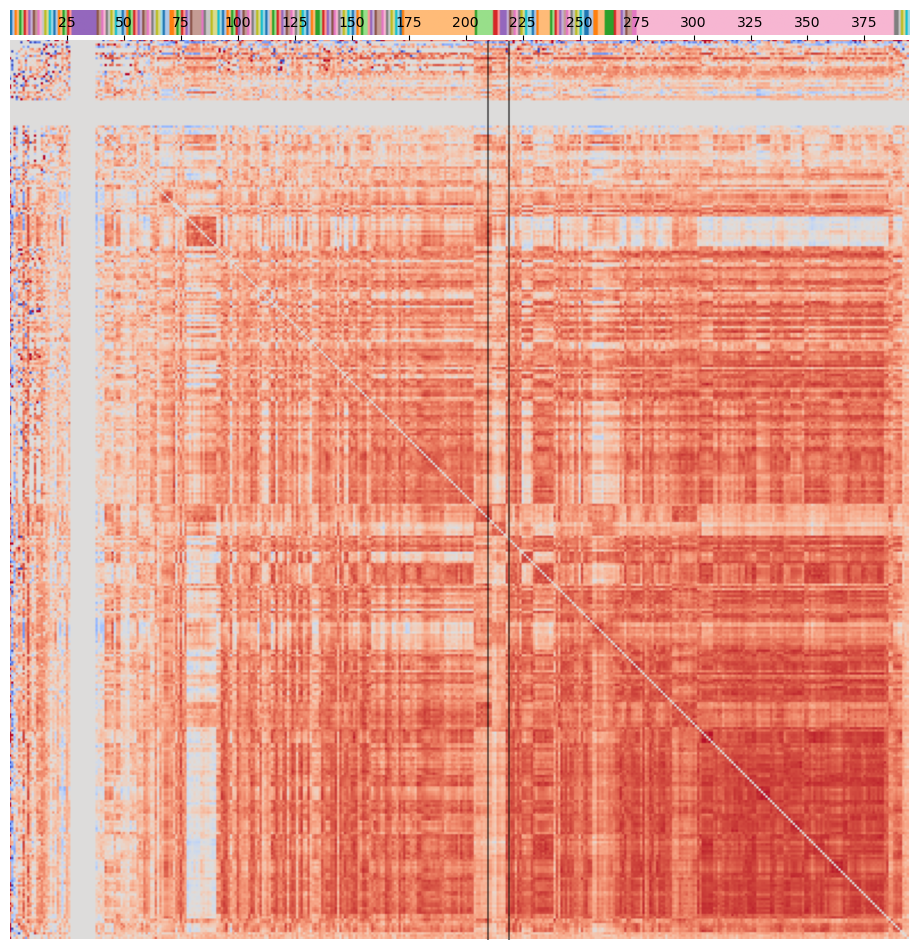

Cluster:: 59	KO: K03841  FBP, fbp; fructose-1,6-bisphosphatase I [EC:3.1.3.11]
Cluster:: 59	KO: K14709  SLC39A1_2_3, ZIP1_2_3; solute carrier family 39 (zinc transporter), member 1/2/3
Cluster:: 61	KO: K14716  SLC39A10, ZIP10; solute carrier family 39 (zinc transporter), member 10
Cluster:: 61	KO: K14719  SLC39A13, ZIP13; solute carrier family 39 (zinc transporter), member 13
Cluster:: 63	KO: K14693  SLC30A6, ZNT6; solute carrier family 30 (zinc transporter), member 6
Cluster:: 62	KO: K14720  SLC39A14, ZIP14; solute carrier family 39 (zinc transporter), member 14
Cluster:: 62	KO: K14688  SLC30A1, ZNT1; solute carrier family 30 (zinc transporter), member 1
Cluster:: 62	KO: K14692  SLC30A5_7, ZNT5_7, MTP, MSC2; solute carrier family 30 (zinc transporter), member 5/7
Cluster:: 105	KO: K18895  iroC; ATP-binding cassette, subfamily B, salmochelin/enterobactin exporter
Cluster:: 104	KO: K00362  nirB; nitrite reductase (NADH) large subunit [EC:1.7.1.15]


In [497]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [210,219]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [506]:
tselect=2.5

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


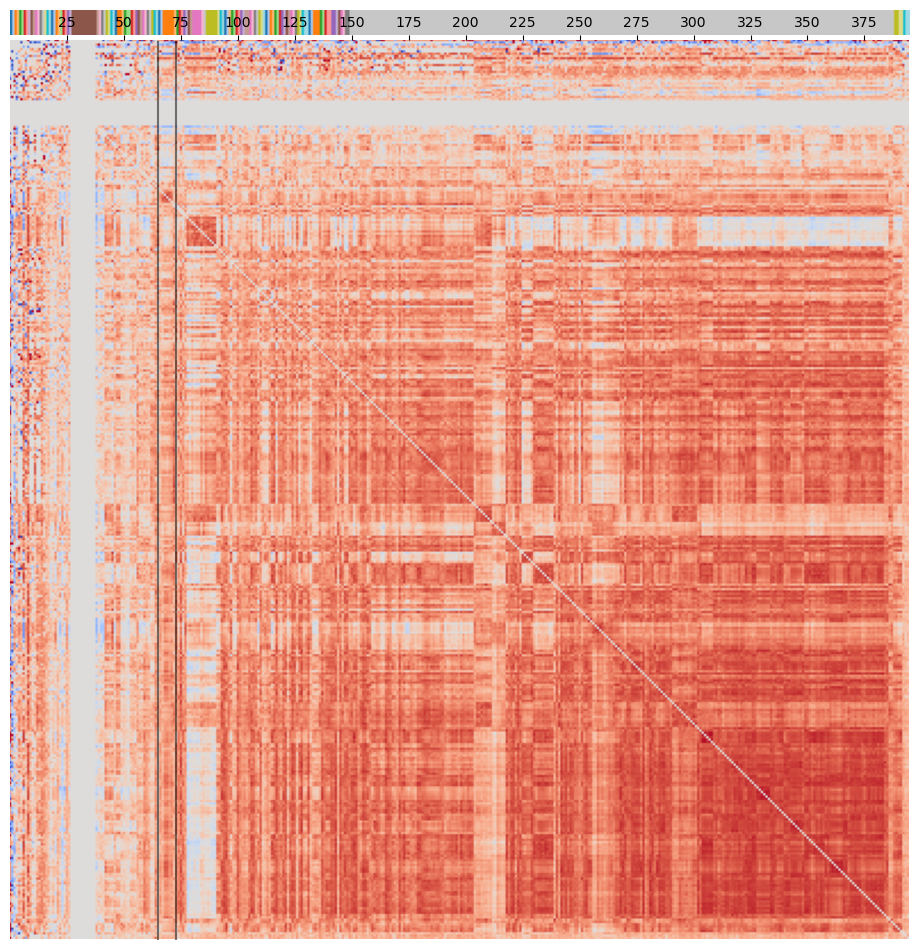

Cluster:: 88	KO: K02575  NRT2, narK, nrtP, nasA; MFS transporter, NNP family, nitrate/nitrite transporter
Cluster:: 85	KO: K25109  sirA, fecB, cbrA; iron-siderophore transport system substrate-binding protein
Cluster:: 18	KO: K02695  psaH; photosystem I subunit VI
Cluster:: 18	KO: K02721  psbW; photosystem II PsbW protein
Cluster:: 18	KO: K03541  psbR; photosystem II 10kDa protein
Cluster:: 18	KO: K02701  psaN; photosystem I subunit PsaN
Cluster:: 18	KO: K14332  psaO; photosystem I subunit PsaO
Cluster:: 84	KO: K22071  FDX2; ferredoxin-2, mitochondrial
Cluster:: 83	KO: K23725  iroB; enterobactin C-glucosyltransferase [EC:2.4.1.369]


In [509]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [65,73]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [522]:
tselect=2.375

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


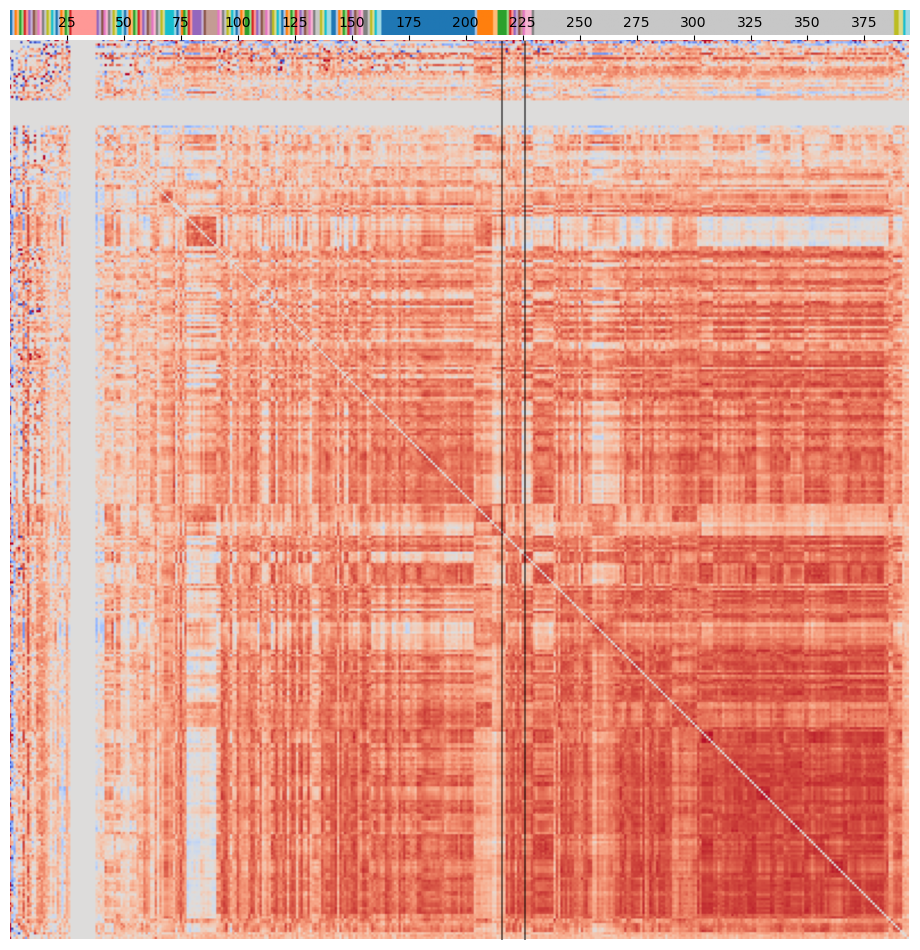

Cluster:: 46	KO: K14688  SLC30A1, ZNT1; solute carrier family 30 (zinc transporter), member 1
Cluster:: 46	KO: K14692  SLC30A5_7, ZNT5_7, MTP, MSC2; solute carrier family 30 (zinc transporter), member 5/7
Cluster:: 57	KO: K18895  iroC; ATP-binding cassette, subfamily B, salmochelin/enterobactin exporter
Cluster:: 56	KO: K00362  nirB; nitrite reductase (NADH) large subunit [EC:1.7.1.15]
Cluster:: 55	KO: K00176  korD, oorD; 2-oxoglutarate ferredoxin oxidoreductase subunit delta [EC:1.2.7.3]
Cluster:: 54	KO: K07684  narL; two-component system, NarL family, nitrate/nitrite response regulator NarL
Cluster:: 53	KO: K03699  tlyC; magnesium and cobalt exporter, CNNM family
Cluster:: 52	KO: K15578  nrtC, nasD; nitrate/nitrite transport system ATP-binding protein [EC:7.3.2.4]
Cluster:: 51	KO: K04017  nrfF; formate-dependent nitrite reductase complex subunit NrfF
Cluster:: 48	KO: K13859  SLC4A8; solute carrier family 4 (sodium bicarbonate cotransporter), member 8
Cluster:: 47	KO: K14691  SLC30A4,

In [523]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [216,226]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [533]:
tselect=2.36

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


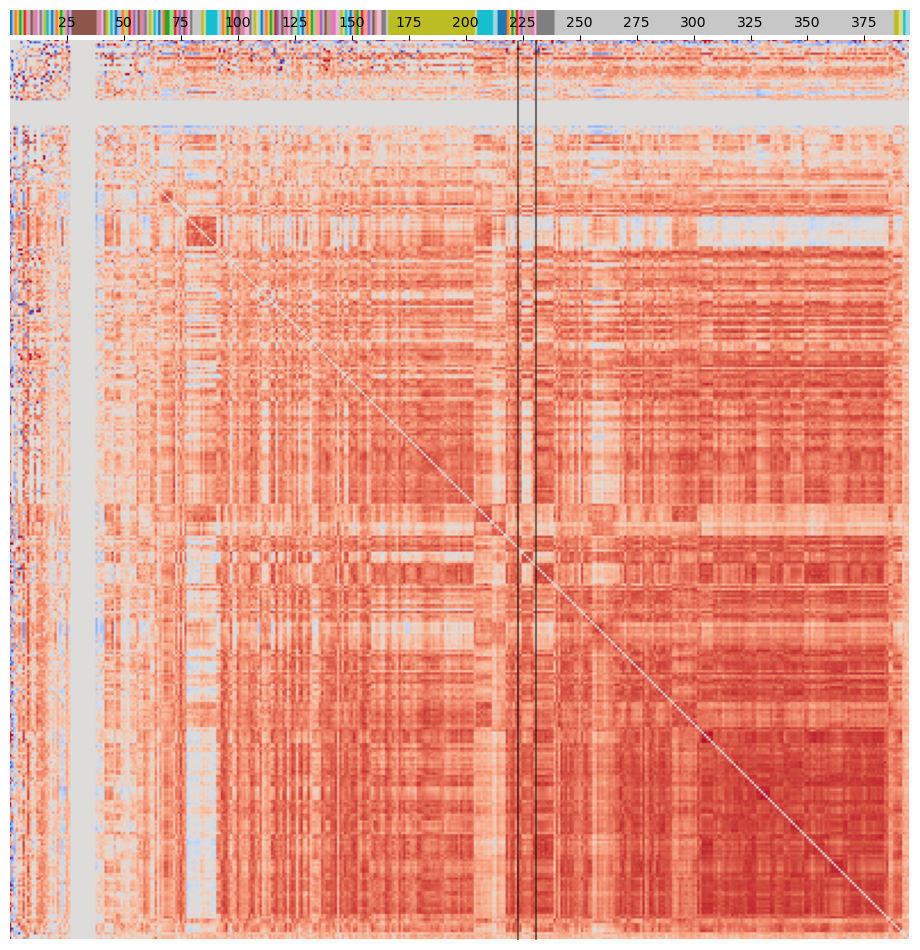

Cluster:: 57	KO: K15578  nrtC, nasD; nitrate/nitrite transport system ATP-binding protein [EC:7.3.2.4]
Cluster:: 56	KO: K04017  nrfF; formate-dependent nitrite reductase complex subunit NrfF
Cluster:: 51	KO: K13859  SLC4A8; solute carrier family 4 (sodium bicarbonate cotransporter), member 8
Cluster:: 50	KO: K14691  SLC30A4, ZNT4; solute carrier family 30 (zinc transporter), member 4
Cluster:: 50	KO: K14695  SLC30A8, ZNT8; solute carrier family 30 (zinc transporter), member 8
Cluster:: 50	KO: K00909  GRK1_7; rhodopsin kinase [EC:2.7.11.14]
Cluster:: 55	KO: K02712  psbK; photosystem II PsbK protein
Cluster:: 54	KO: K15577  nrtB, nasE, cynB; nitrate/nitrite transport system permease protein
Cluster:: 52	KO: K11708  troC, mntC, znuB; manganese/zinc/iron transport system permease protein


In [534]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [223,231]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2.36

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


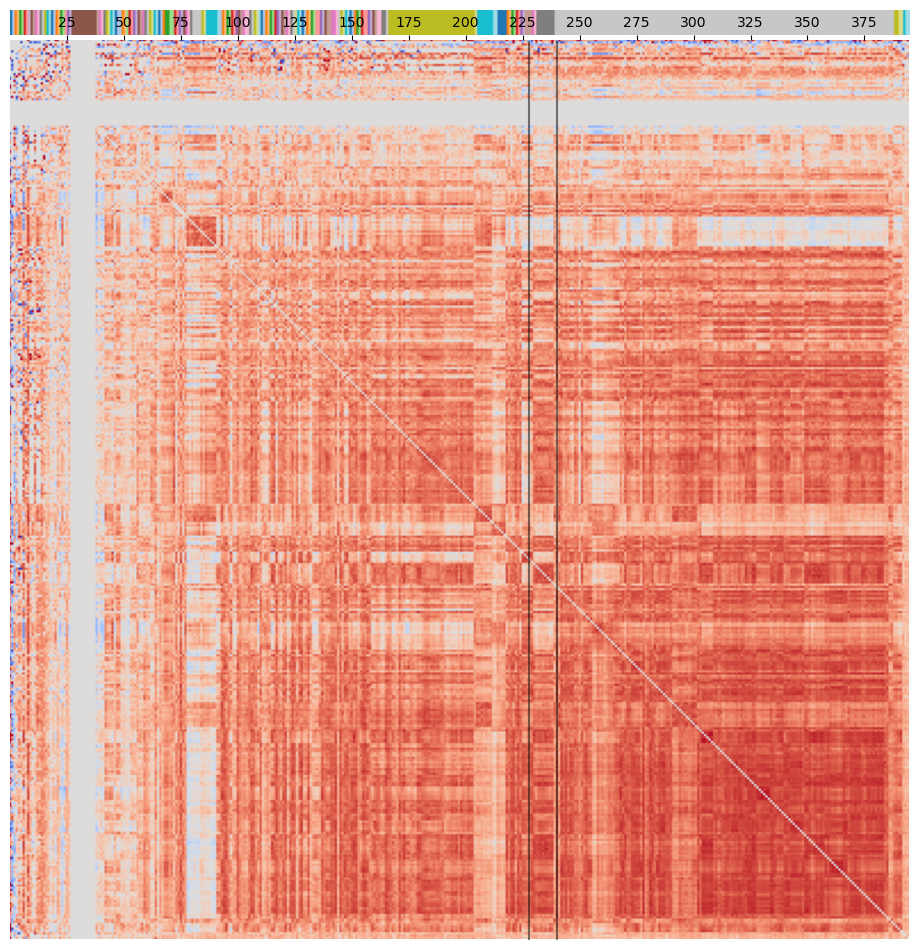

Cluster:: 50	KO: K00909  GRK1_7; rhodopsin kinase [EC:2.7.11.14]
Cluster:: 55	KO: K02712  psbK; photosystem II PsbK protein
Cluster:: 54	KO: K15577  nrtB, nasE, cynB; nitrate/nitrite transport system permease protein
Cluster:: 52	KO: K11708  troC, mntC, znuB; manganese/zinc/iron transport system permease protein
Cluster:: 52	KO: K00187  vorB; 2-oxoisovalerate ferredoxin oxidoreductase beta subunit [EC:1.2.7.7]
Cluster:: 52	KO: K07230  p19, ftrA; periplasmic iron binding protein
Cluster:: 52	KO: K05368  fre, ubiB; NAD(P)H-flavin reductase [EC:1.5.1.41]
Cluster:: 52	KO: K09818  ABC.MN.S; manganese/iron transport system substrate-binding protein
Cluster:: 52	KO: K11704  mtsA; iron/zinc/manganese/copper transport system substrate-binding protein
Cluster:: 52	KO: K11606  sitD; manganese/iron transport system permease protein
Cluster:: 52	KO: K11605  sitC; manganese/iron transport system permease protein
Cluster:: 53	KO: K03840  fldB; flavodoxin II
Cluster:: 53	KO: K02723  psbY; photosystem 

In [536]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [228,240]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [549]:
tselect=2.275

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


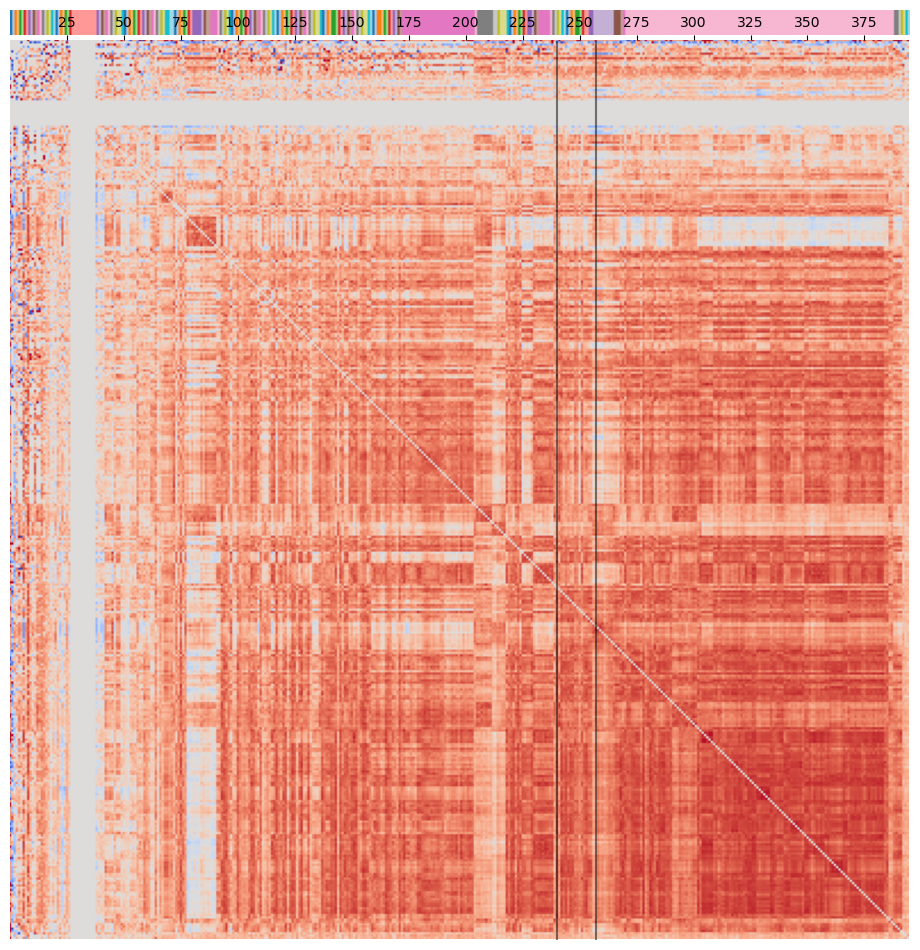

Cluster:: 85	KO: K02723  psbY; photosystem II PsbY protein
Cluster:: 84	KO: K01783  rpe, RPE; ribulose-phosphate 3-epimerase [EC:5.1.3.1]
Cluster:: 83	KO: K11710  troB, mntB, znuC; manganese/zinc/iron transport system ATP- binding protein [EC:7.2.2.5]
Cluster:: 82	KO: K07243  FTR, FTH1, efeU; high-affinity iron transporter
Cluster:: 81	KO: K11107  yfaE; ferredoxin
Cluster:: 80	KO: K01624  FBA, fbaA; fructose-bisphosphate aldolase, class II [EC:4.1.2.13]
Cluster:: 68	KO: K12346  SMF; metal iron transporter
Cluster:: 69	KO: K10850  narT; MFS transporter, NNP family, putative nitrate transporter
Cluster:: 70	KO: K12240  pchF; L-cysteine---[L-cysteinyl-carrier protein] ligase PchF [EC:6.2.1.69]
Cluster:: 70	KO: K00533  E1.12.7.2L; ferredoxin hydrogenase large subunit [EC:1.12.7.2]
Cluster:: 79	KO: K13575  SLC4A4, NBC1; solute carrier family 4 (sodium bicarbonate cotransporter), member 4
Cluster:: 78	KO: K04641  bop; bacteriorhodopsin
Cluster:: 71	KO: K14750  etbAc; ethylbenzene dioxygenase

In [550]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [240,257]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2.275

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


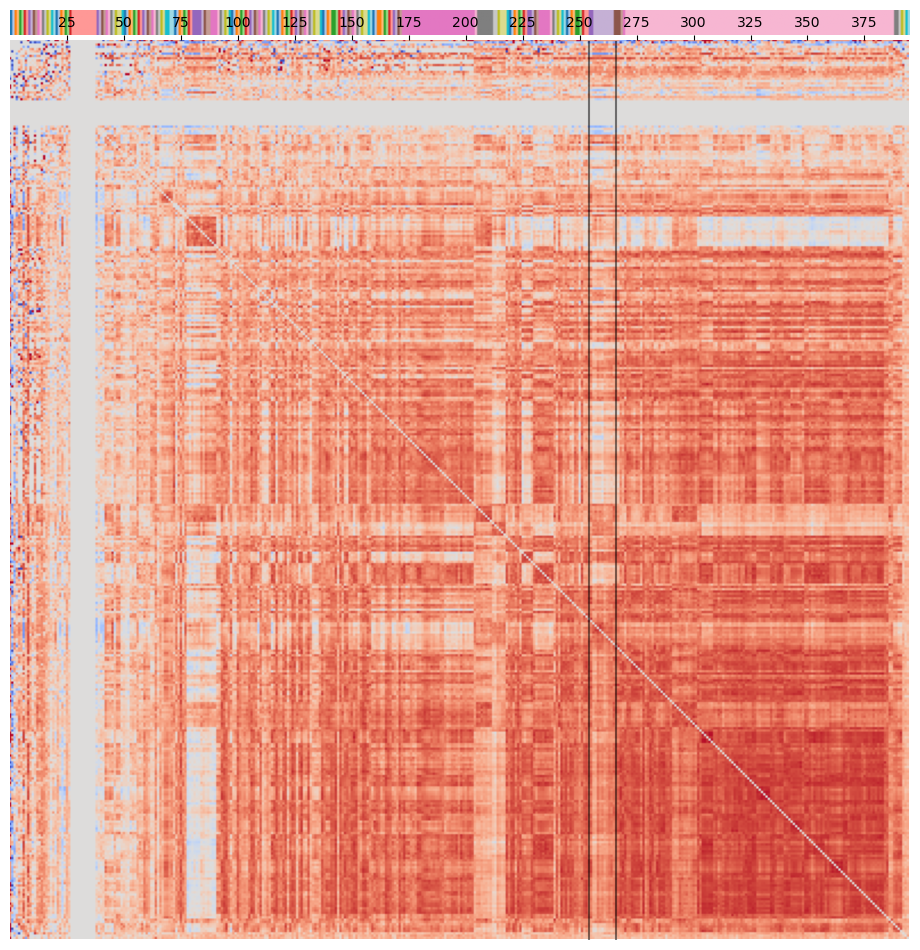

Cluster:: 72	KO: K02719  psbU; photosystem II PsbU protein
Cluster:: 72	KO: K08901  psbQ; photosystem II oxygen-evolving enhancer protein 3
Cluster:: 73	KO: K13861  SLC4A10, NCBE; solute carrier family 4 (sodium bicarbonate transporter), member 10
Cluster:: 73	KO: K18246  CA4; carbonic anhydrase 4 [EC:4.2.1.1]
Cluster:: 73	KO: K18245  CA2; carbonic anhydrase 2 [EC:4.2.1.1]
Cluster:: 73	KO: K01672  CA; carbonic anhydrase [EC:4.2.1.1]
Cluster:: 73	KO: K13858  SLC4A7, NBC3; solute carrier family 4 (sodium bicarbonate cotransporter), member 7
Cluster:: 73	KO: K14736  TF; transferrin
Cluster:: 73	KO: K14714  SLC39A8, ZIP8; solute carrier family 39 (zinc transporter), member 8
Cluster:: 73	KO: K14718  SLC39A12, ZIP12; solute carrier family 39 (zinc transporter), member 12
Cluster:: 73	KO: K14715  SLC39A9, ZIP9; solute carrier family 39 (zinc transporter), member 9
Cluster:: 74	KO: K00592  RBCMT; [ribulose-bisphosphate carboxylase]/[fructose-bisphosphate aldolase]-lysine N-methyltransferase [

In [551]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [254,266]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [567]:
tselect=2.15

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


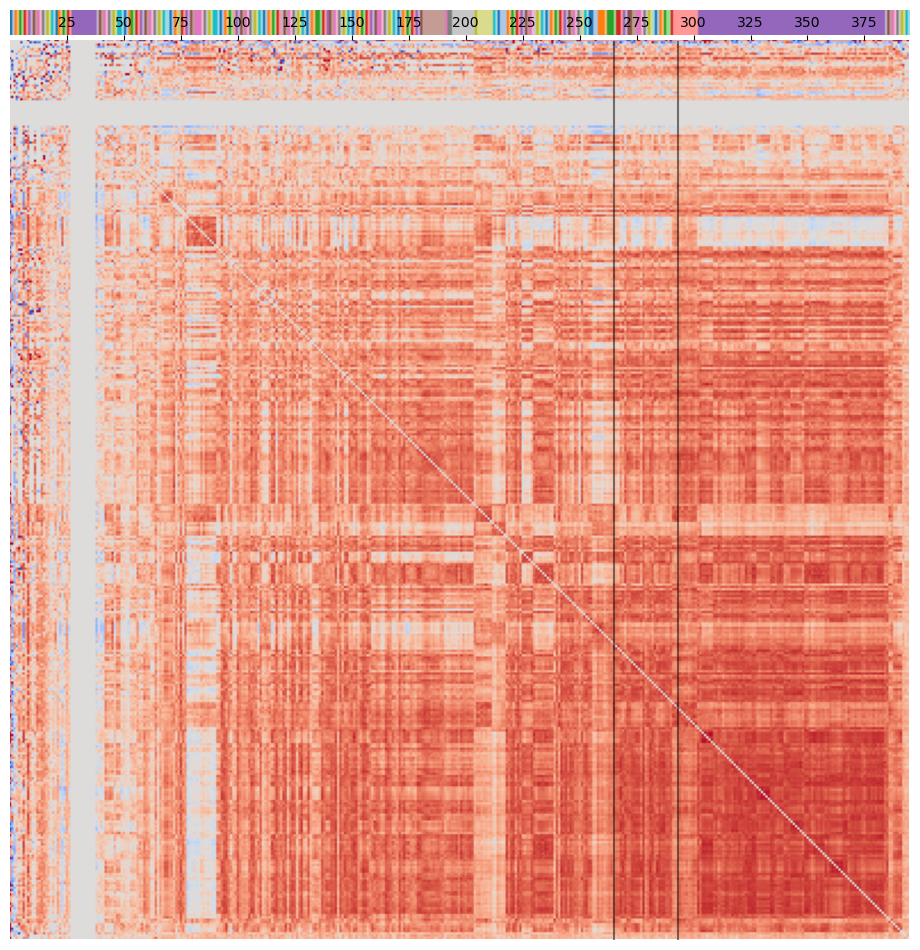

Cluster:: 104	KO: K00592  RBCMT; [ribulose-bisphosphate carboxylase]/[fructose-bisphosphate aldolase]-lysine N-methyltransferase [EC:2.1.1.127 2.1.1.259]
Cluster:: 103	KO: K21563  dnr; CRP/FNR family transcriptional regulator, dissimilatory nitrate respiration regulator
Cluster:: 103	KO: K22552  mmcO; multicopper oxidase [EC:1.16.3.1]
Cluster:: 129	KO: K02707  psbE; photosystem II cytochrome b559 subunit alpha
Cluster:: 128	KO: K01602  rbcS, cbbS; ribulose-bisphosphate carboxylase small chain [EC:4.1.1.39]
Cluster:: 127	KO: K24147  entH; proofreading thioesterase EntH
Cluster:: 105	KO: K15653  mxcG; nonribosomal peptide synthetase MxcG
Cluster:: 105	KO: K04780  dhbF; glyine---[glycyl-carrier protein] ligase [EC:6.2.1.66]
Cluster:: 106	KO: K14578  nahAb, nagAb, ndoA, nbzAb, dntAb; naphthalene 1,2-dioxygenase ferredoxin component
Cluster:: 106	KO: K02696  psaI; photosystem I subunit VIII
Cluster:: 107	KO: K01595  ppc; phosphoenolpyruvate carboxylase [EC:4.1.1.31]
Cluster:: 107	KO: K17892

In [568]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [265,293]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2.15

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


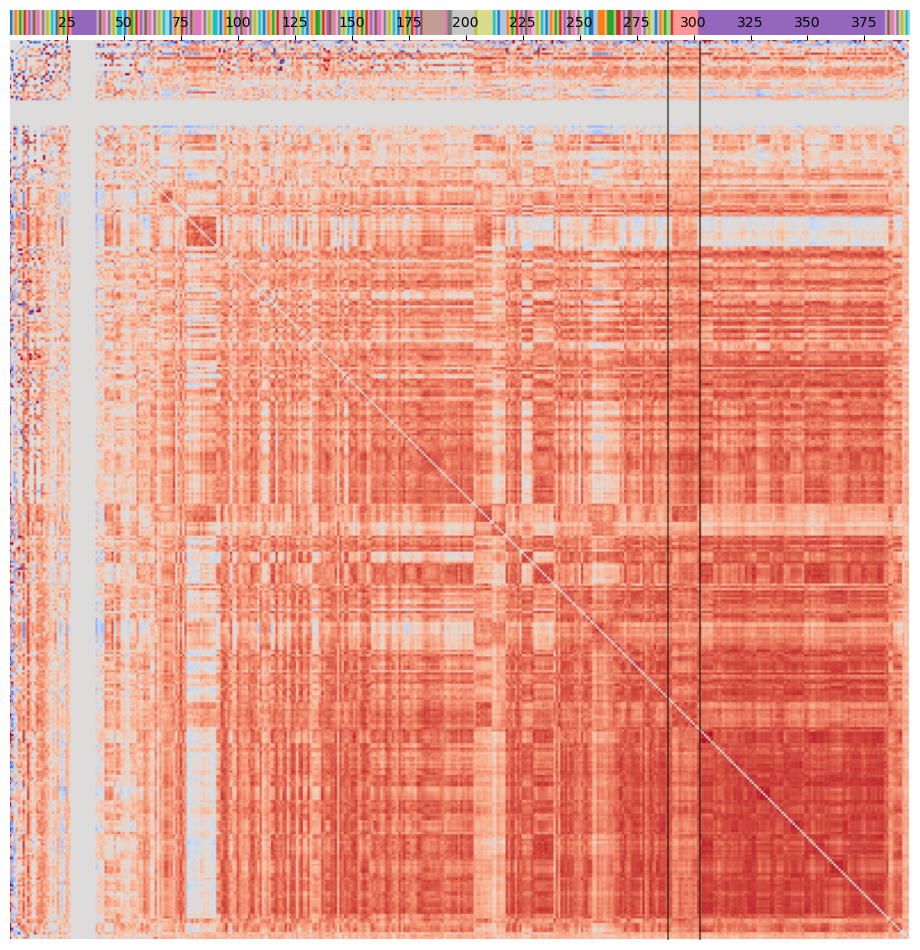

Cluster:: 110	KO: K03320  amt, AMT, MEP; ammonium transporter, Amt family
Cluster:: 113	KO: K14634  TIGAR; fructose-2,6-bisphosphatase [EC:3.1.3.46]
Cluster:: 111	KO: K03542  psbS; photosystem II 22kDa protein
Cluster:: 111	KO: K03839  fldA, nifF, isiB; flavodoxin I
Cluster:: 111	KO: K21480  HO, pbsA1, hmuO; heme oxygenase (biliverdin-producing, ferredoxin) [EC:1.14.15.20]
Cluster:: 111	KO: K02068  STAR1, fetA; UDP-glucose/iron transport system ATP-binding protein
Cluster:: 111	KO: K03322  mntH; manganese transport protein
Cluster:: 111	KO: K14717  SLC39A11, ZIP11; solute carrier family 39 (zinc transporter), member 11
Cluster:: 111	KO: K00284  GLU, gltS; glutamate synthase (ferredoxin) [EC:1.4.7.1]
Cluster:: 111	KO: K02016  ABC.FEV.S; iron complex transport system substrate-binding protein
Cluster:: 111	KO: K16302  CNNM; metal transporter CNNM
Cluster:: 111	KO: K00615  E2.2.1.1, tktA, tktB; transketolase [EC:2.2.1.1]
Cluster:: 111	KO: K00855  PRK, prkB; phosphoribulokinase [EC:2.7.1.1

In [572]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [289,303]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [577]:
tselect=2.1

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


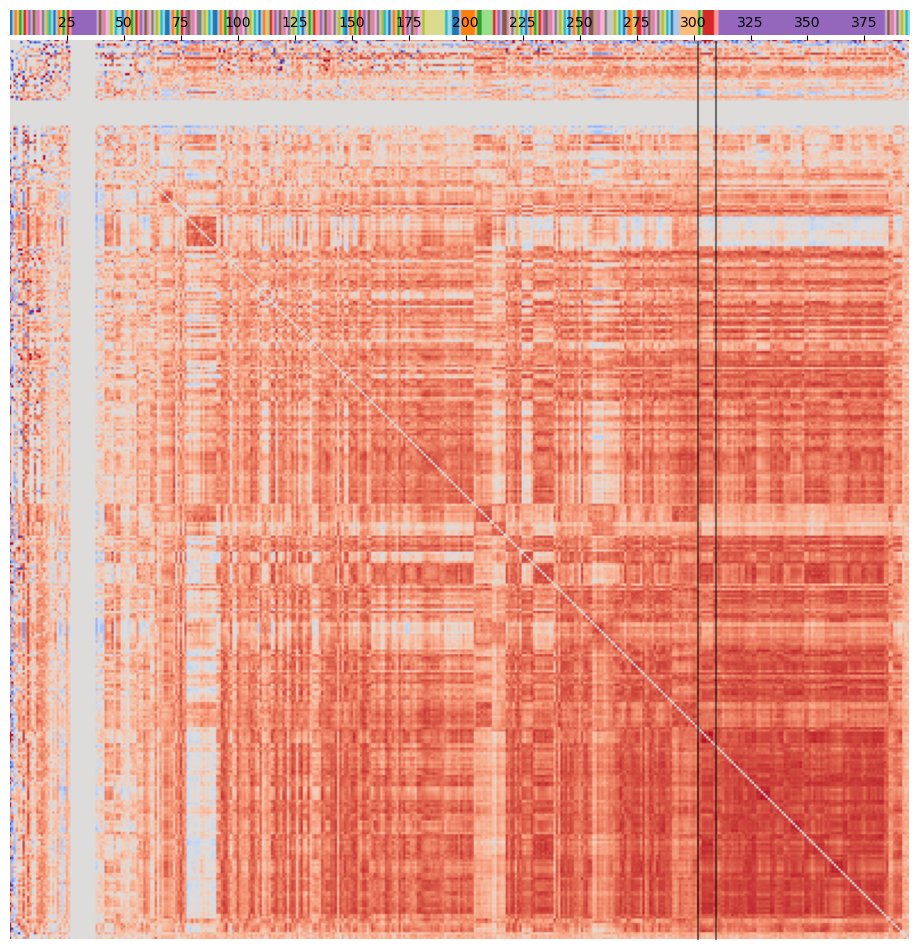

Cluster:: 128	KO: K23188  fepC, fagC, cchE, desF; iron-siderophore transport system ATP-binding protein [EC:7.2.2.17 7.2.2.-]
Cluster:: 127	KO: K22070  FDX1, ADX; ferredoxin-1, mitochondrial
Cluster:: 124	KO: K16090  fiu; catecholate siderophore receptor
Cluster:: 124	KO: K15721  fyuA; pesticin/yersiniabactin receptor
Cluster:: 124	KO: K11532  glpX-SEBP; fructose-1,6-bisphosphatase II / sedoheptulose-1,7-bisphosphatase [EC:3.1.3.11 3.1.3.37]
Cluster:: 124	KO: K16087  TC.FEV.OM3, tbpA, hemR, lbpA, hpuB, bhuR, hugA, hmbR; hemoglobin/transferrin/lactoferrin receptor protein
Cluster:: 124	KO: K19611  fepA, pfeA, iroN, pirA; ferric enterobactin receptor
Cluster:: 125	KO: K04786  irp1, HMWP1; yersiniabactin nonribosomal peptide/polyketide synthase
Cluster:: 125	KO: K04791  mbtD; mycobactin polyketide synthetase MbtD


In [581]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [302,310]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [584]:
tselect=2.05

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


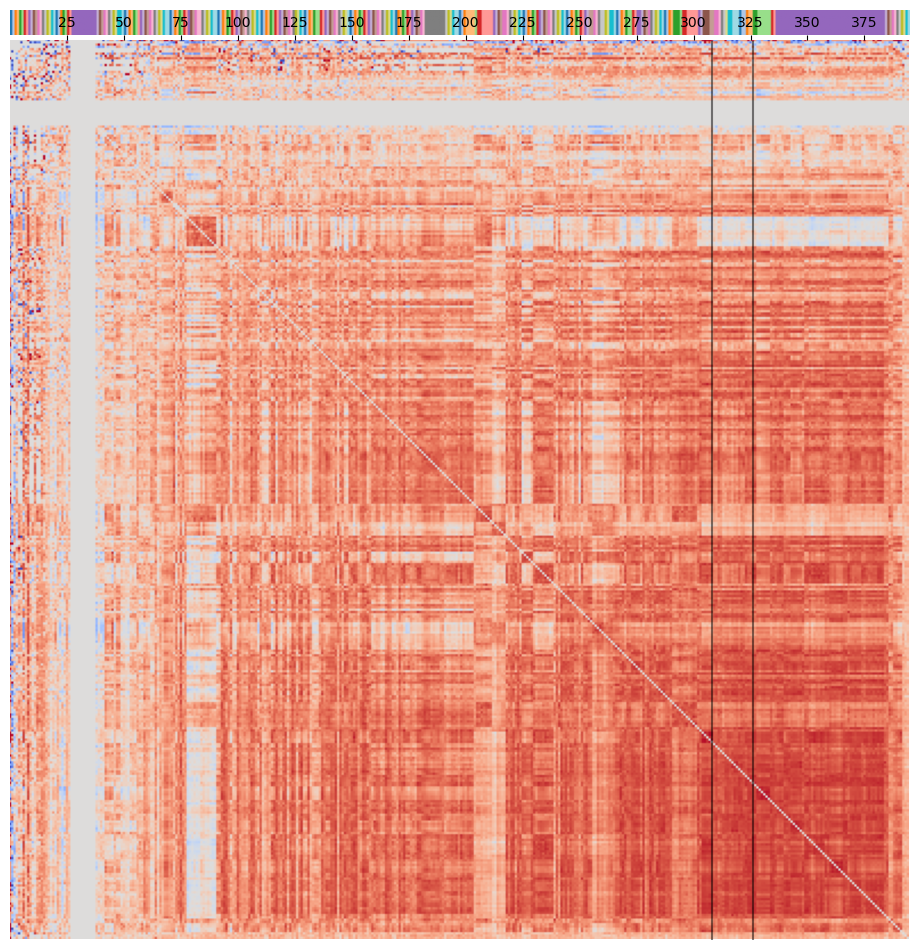

Cluster:: 133	KO: K19611  fepA, pfeA, iroN, pirA; ferric enterobactin receptor
Cluster:: 134	KO: K04786  irp1, HMWP1; yersiniabactin nonribosomal peptide/polyketide synthase
Cluster:: 134	KO: K04791  mbtD; mycobactin polyketide synthetase MbtD
Cluster:: 149	KO: K00529  hcaD; 3-phenylpropionate/trans-cinnamate dioxygenase ferredoxin reductase component [EC:1.18.1.3]
Cluster:: 148	KO: K08225  entS; MFS transporter, ENTS family, enterobactin (siderophore) exporter
Cluster:: 147	KO: K00368  nirK; nitrite reductase (NO-forming) [EC:1.7.2.1]
Cluster:: 146	KO: K09820  ABC.MN.A; manganese/iron transport system ATP-binding protein
Cluster:: 135	KO: K06441  E1.12.7.2G; ferredoxin hydrogenase gamma subunit [EC:1.12.7.2]
Cluster:: 135	KO: K02722  psbX; photosystem II PsbX protein
Cluster:: 136	KO: K02708  psbF; photosystem II cytochrome b559 subunit beta
Cluster:: 136	KO: K02697  psaJ; photosystem I subunit IX
Cluster:: 136	KO: K02711  psbJ; photosystem II PsbJ protein
Cluster:: 145	KO: K02010  af

In [586]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [308,326]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2.05

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


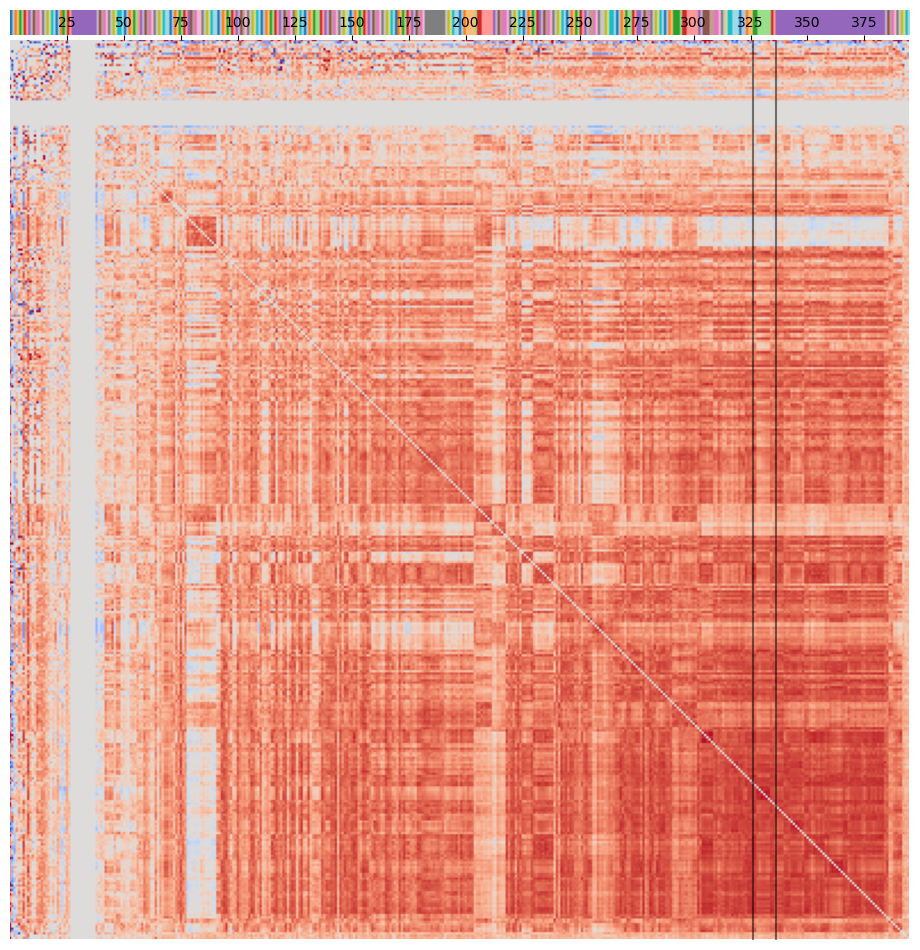

Cluster:: 139	KO: K00174  korA, oorA, oforA; 2-oxoglutarate/2-oxoacid ferredoxin oxidoreductase subunit alpha [EC:1.2.7.3 1.2.7.11]
Cluster:: 139	KO: K00179  iorA; indolepyruvate ferredoxin oxidoreductase, alpha subunit [EC:1.2.7.8]
Cluster:: 140	KO: K02703  psbA; photosystem II P680 reaction center D1 protein [EC:1.10.3.9]
Cluster:: 140	KO: K02706  psbD; photosystem II P680 reaction center D2 protein [EC:1.10.3.9]
Cluster:: 140	KO: K02705  psbC; photosystem II CP43 chlorophyll apoprotein
Cluster:: 140	KO: K02704  psbB; photosystem II CP47 chlorophyll apoprotein
Cluster:: 140	KO: K02689  psaA; photosystem I P700 chlorophyll a apoprotein A1 [EC:1.97.1.12]
Cluster:: 140	KO: K02690  psaB; photosystem I P700 chlorophyll a apoprotein A2 [EC:1.97.1.12]
Cluster:: 143	KO: K22339  hylB; formate dehydrogenase (NAD+, ferredoxin) subunit B [EC:1.17.1.11]
Cluster:: 142	KO: K00171  porD; pyruvate ferredoxin oxidoreductase delta subunit [EC:1.2.7.1]
Cluster:: 141	KO: K11607  sitB; manganese/iron tran

In [587]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [326,336]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [588]:
tselect=2

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


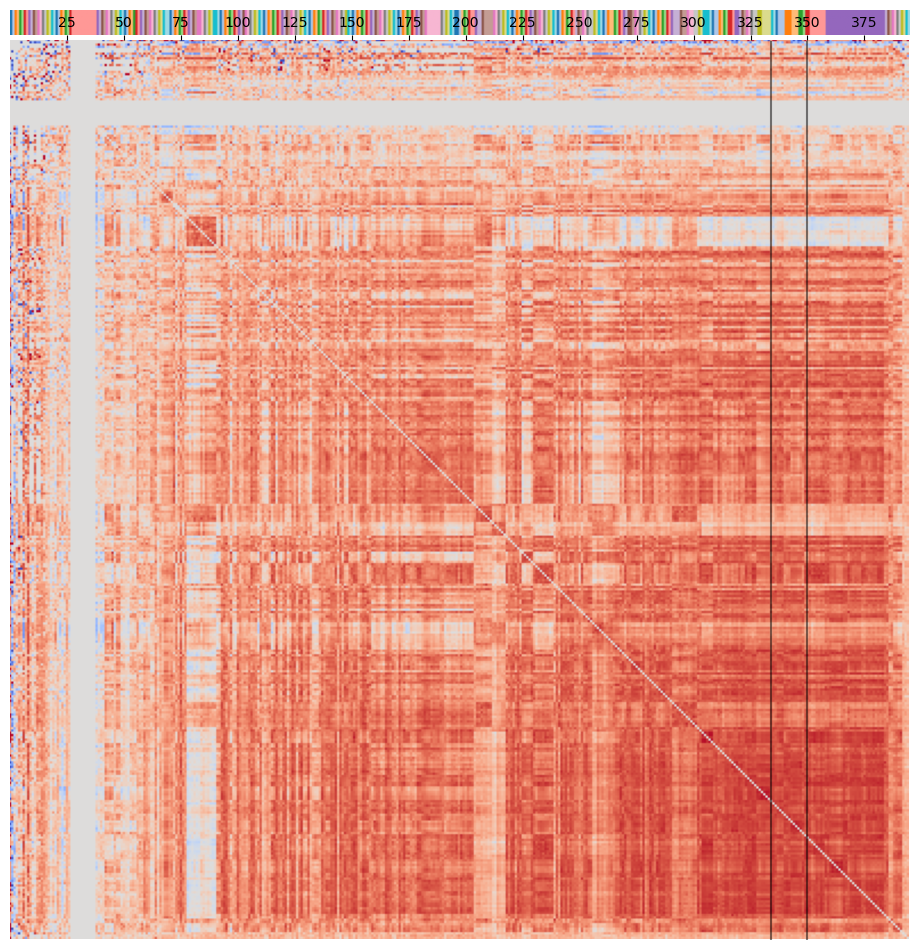

Cluster:: 169	KO: K22339  hylB; formate dehydrogenase (NAD+, ferredoxin) subunit B [EC:1.17.1.11]
Cluster:: 168	KO: K00171  porD; pyruvate ferredoxin oxidoreductase delta subunit [EC:1.2.7.1]
Cluster:: 167	KO: K11607  sitB; manganese/iron transport system ATP-binding protein
Cluster:: 159	KO: K04755  fdx; ferredoxin, 2Fe-2S
Cluster:: 159	KO: K01012  bioB; biotin synthase [EC:2.8.1.6]
Cluster:: 159	KO: K00264  GLT1; glutamate synthase (NADH) [EC:1.4.1.14]
Cluster:: 160	KO: K18248  andAb; anthranilate 1,2-dioxygenase ferredoxin component
Cluster:: 160	KO: K02363  entE, dhbE, vibE, mxcE; 2,3-dihydroxybenzoate---[aryl-carrier protein] ligase [EC:6.3.2.14 6.2.1.71]
Cluster:: 160	KO: K04789  mbtE; mycobactin peptide synthetase MbtE
Cluster:: 161	KO: K02699  psaL; photosystem I subunit XI
Cluster:: 161	KO: K02694  psaF; photosystem I subunit III
Cluster:: 161	KO: K02692  psaD; photosystem I subunit II
Cluster:: 162	KO: K02720  psbV; photosystem II cytochrome c550
Cluster:: 162	KO: K02713  psb

In [592]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [334,350]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=2

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


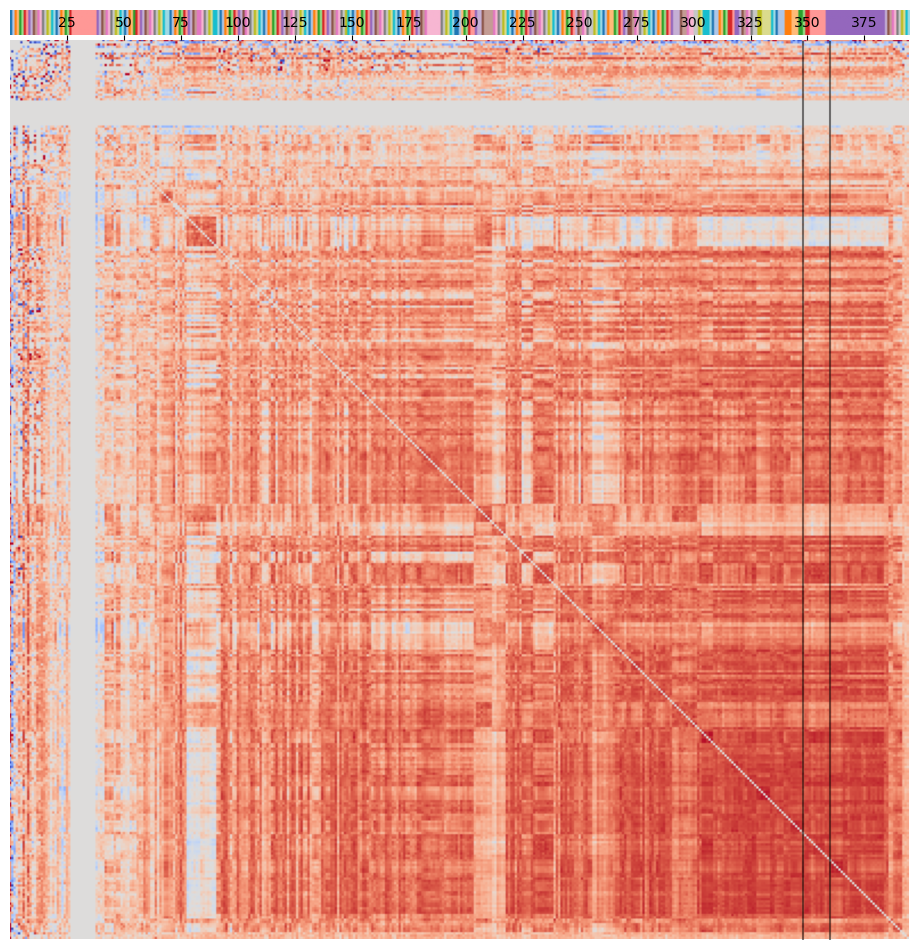

Cluster:: 166	KO: K01673  cynT, can; carbonic anhydrase [EC:4.2.1.1]
Cluster:: 163	KO: K02361  entC; isochorismate synthase [EC:5.4.4.2]
Cluster:: 163	KO: K00175  korB, oorB, oforB; 2-oxoglutarate/2-oxoacid ferredoxin oxidoreductase subunit beta [EC:1.2.7.3 1.2.7.11]
Cluster:: 164	KO: K04759  feoB; ferrous iron transport protein B
Cluster:: 164	KO: K11959  urtA; urea transport system substrate-binding protein
Cluster:: 164	KO: K02012  afuA, fbpA; iron(III) transport system substrate-binding protein
Cluster:: 164	KO: K11645  fbaB; fructose-bisphosphate aldolase, class I [EC:4.1.2.13]
Cluster:: 164	KO: K11604  sitA; manganese/iron transport system substrate-binding protein
Cluster:: 164	KO: K03594  bfr; bacterioferritin [EC:1.16.3.1]
Cluster:: 164	KO: K02011  afuB, fbpB; iron(III) transport system permease protein
Cluster:: 165	KO: K04564  SOD2; superoxide dismutase, Fe-Mn family [EC:1.15.1.1]
Cluster:: 165	KO: K05524  fdxA; ferredoxin
Cluster:: 165	KO: K08903  psb28; photosystem II 13kD

In [594]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [348,360]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [597]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


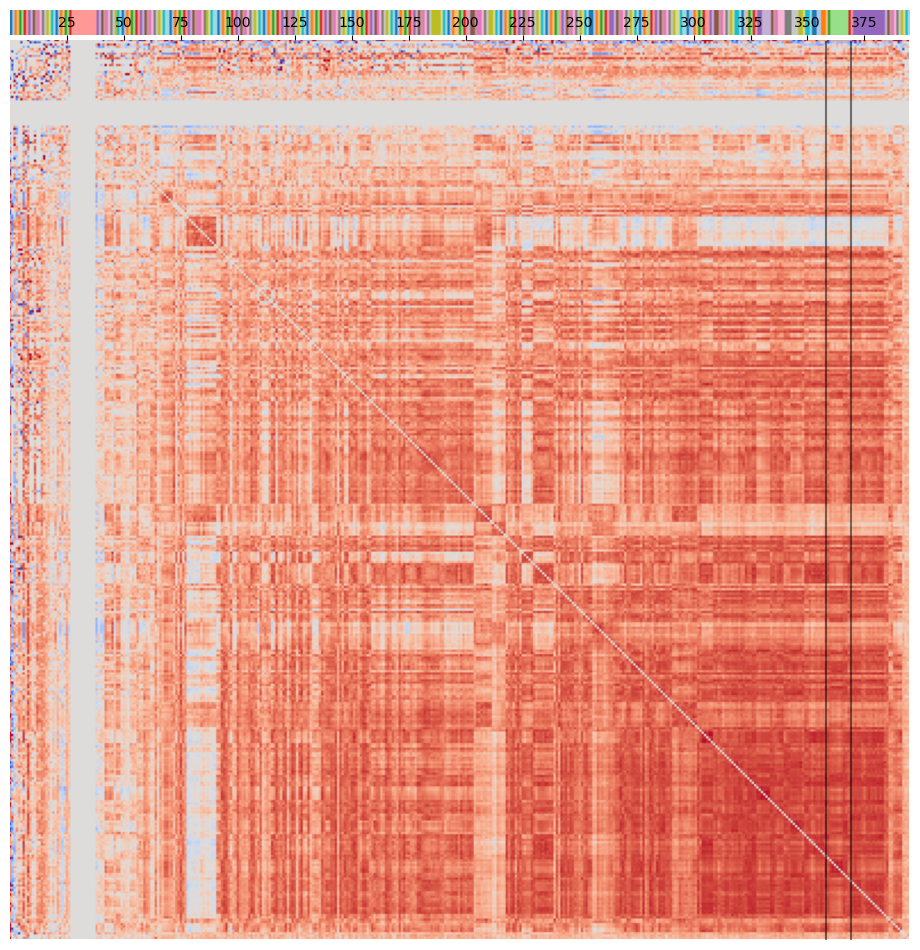

Cluster:: 183	KO: K04564  SOD2; superoxide dismutase, Fe-Mn family [EC:1.15.1.1]
Cluster:: 182	KO: K05524  fdxA; ferredoxin
Cluster:: 178	KO: K08903  psb28; photosystem II 13kDa protein
Cluster:: 178	KO: K02716  psbO; photosystem II oxygen-evolving enhancer protein 1
Cluster:: 178	KO: K08902  psb27; photosystem II Psb27 protein
Cluster:: 178	KO: K01623  ALDO; fructose-bisphosphate aldolase, class I [EC:4.1.2.13]
Cluster:: 178	KO: K01803  TPI, tpiA; triosephosphate isomerase (TIM) [EC:5.3.1.1]
Cluster:: 178	KO: K00927  PGK, pgk; phosphoglycerate kinase [EC:2.7.2.3]
Cluster:: 178	KO: K02573  napG; ferredoxin-type protein NapG
Cluster:: 178	KO: K08906  petJ; cytochrome c6
Cluster:: 181	KO: K00518  sodN; nickel superoxide dismutase [EC:1.15.1.1]
Cluster:: 180	KO: K15762  tmoC, tbuB, touC; toluene monooxygenase system ferredoxin subunit


In [600]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [358,369]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


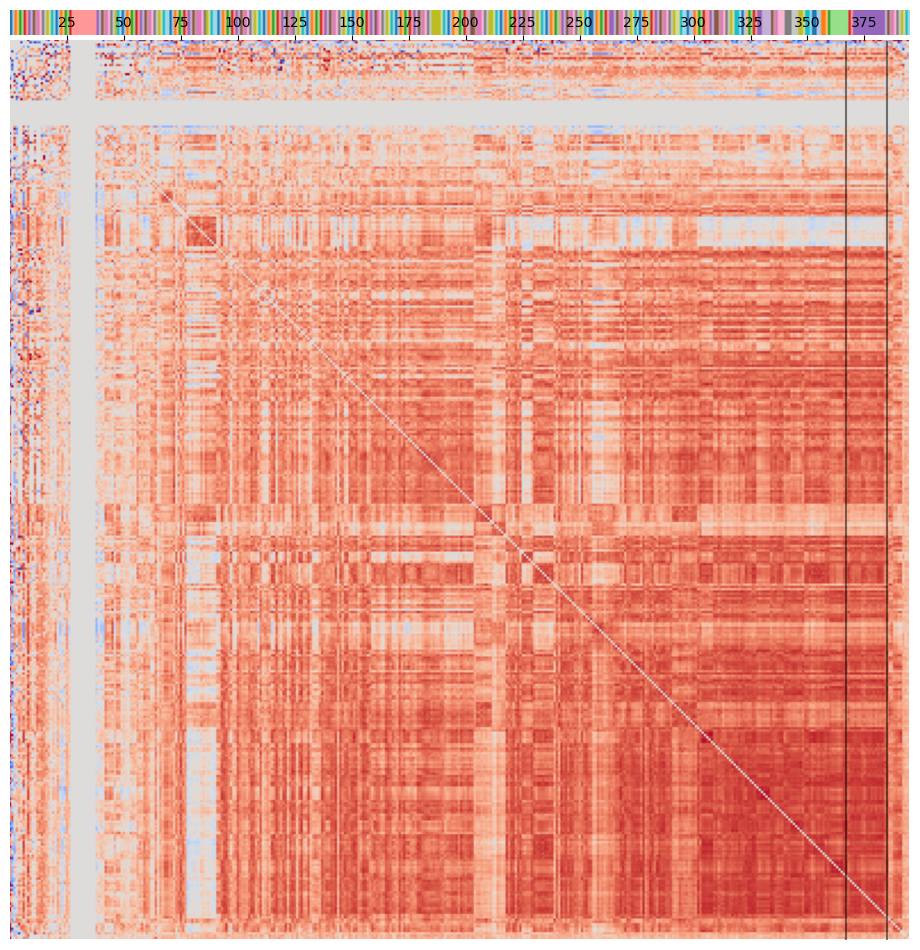

Cluster:: 178	KO: K08906  petJ; cytochrome c6
Cluster:: 181	KO: K00518  sodN; nickel superoxide dismutase [EC:1.15.1.1]
Cluster:: 180	KO: K15762  tmoC, tbuB, touC; toluene monooxygenase system ferredoxin subunit
Cluster:: 179	KO: K04792  mbtF; mycobactin peptide synthetase MbtF
Cluster:: 179	KO: K04018  nrfG; formate-dependent nitrite reductase complex subunit NrfG
Cluster:: 179	KO: K12239  pchE; L-cysteine---[L-cysteinyl-carrier protein] ligase PchE [EC:6.2.1.69]
Cluster:: 179	KO: K04788  mbtB; mycobactin phenyloxazoline synthetase
Cluster:: 179	KO: K02552  menF; menaquinone-specific isochorismate synthase [EC:5.4.4.2]
Cluster:: 179	KO: K04090  E1.2.7.8; indolepyruvate ferredoxin oxidoreductase [EC:1.2.7.8]
Cluster:: 179	KO: K04784  irp2, HMWP2; yersiniabactin nonribosomal peptide synthetase
Cluster:: 179	KO: K14581  nahAa, nagAa, ndoR, nbzAa, dntAa; naphthalene 1,2-dioxygenase ferredoxin reductase component [EC:1.18.1.7]
Cluster:: 179	KO: K21949  sbnA; N-(2-amino-2-carboxyethyl)-L-gl

In [603]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [367,385]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [608]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


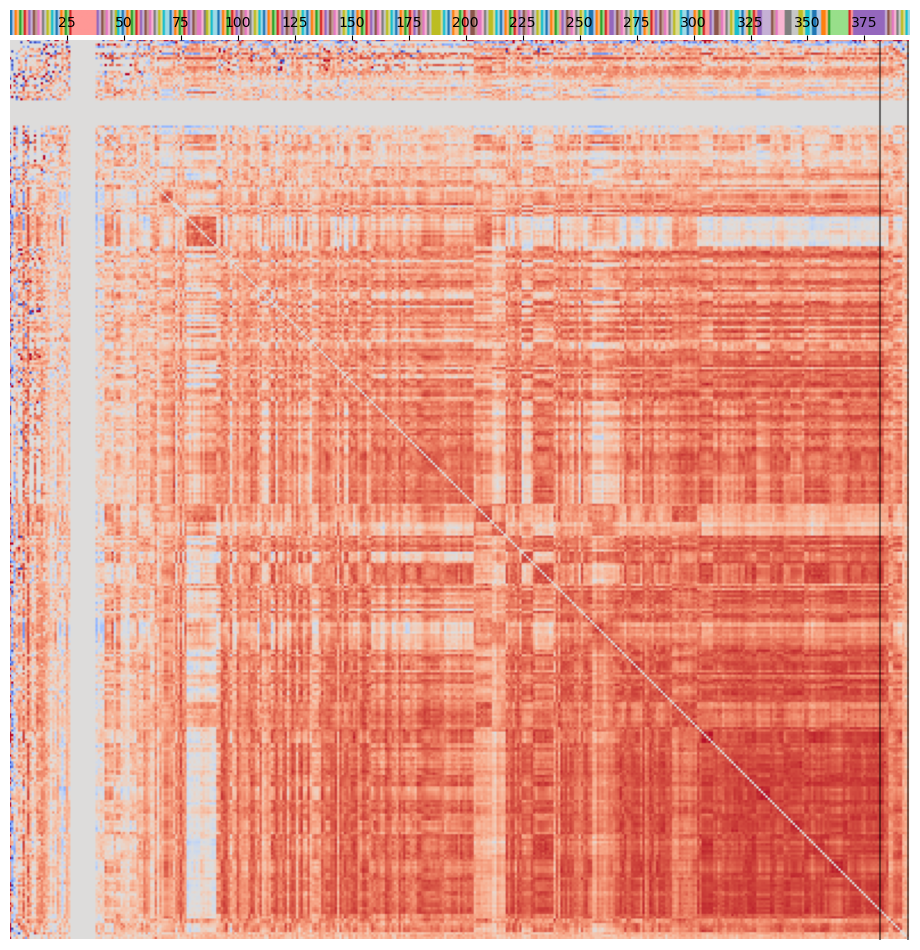

Cluster:: 179	KO: K21567  fnr; ferredoxin/flavodoxin---NADP+ reductase [EC:1.18.1.2 1.19.1.1]
Cluster:: 179	KO: K02069  STAR2, fetB; UDP-glucose/iron transport system permease protein
Cluster:: 197	KO: K02691  psaC; photosystem I iron-sulfur center [EC:1.97.1.12]
Cluster:: 198	KO: K02698  psaK; photosystem I subunit X
Cluster:: 208	KO: K02013  ABC.FEV.A; iron complex transport system ATP-binding protein [EC:7.2.2.-]
Cluster:: 209	KO: K04569  CCS; copper chaperone for superoxide dismutase
Cluster:: 250	KO: K12243  pchR; AraC family transcriptional regulator, transcriptional activator of the genes for pyochelin and ferripyochelin receptors
Cluster:: 251	KO: K03832  tonB; periplasmic protein TonB
Cluster:: 252	KO: K09681  gltC; LysR family transcriptional regulator, transcription activator of glutamate synthase operon
Cluster:: 253	KO: K16088  TC.FEV.OM1, fhuE, fpvA, fptA; outer-membrane receptor for ferric coprogen and ferric-rhodotorulic acid
Cluster:: 295	KO: K23722  pfeE; iron(III)-en

In [611]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [382,394]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


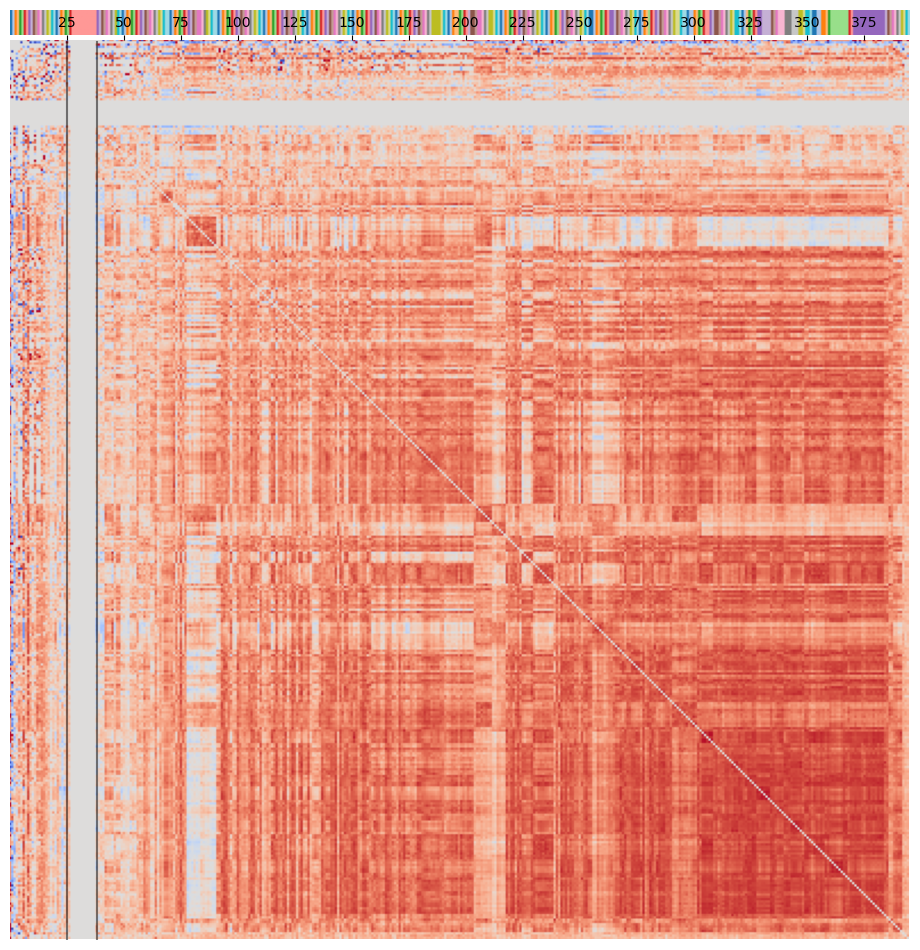

Cluster:: 309	KO: K04250  RHO, OPN2; rhodopsin
Cluster:: 308	KO: K22737  mbfA; erythrin-vacuolar iron transport family protein
Cluster:: 3	KO: K26563  NRT3, NAR2; high-affinity nitrate transporter
Cluster:: 3	KO: K26552  NPF2, GTR, NRT1; MFS transporter, POT/PTR family, nitrate/chloride/glucosinolate transporter
Cluster:: 3	KO: K26548  NPF4, NRT1; MFS transporter, POT/PTR family, nitrate transporter
Cluster:: 3	KO: K08943  pscD; photosystem P840 reaction center protein PscD
Cluster:: 3	KO: K27935  rbcX; RuBisCO chaperone RbcX
Cluster:: 3	KO: K26554  NPF7, NRT1; MFS transporter, POT/PTR family, low-affinity nitrate transporter
Cluster:: 3	KO: K14694  SLC30A11, ZNT11; solute carrier family 30 (zinc transporter), member 11
Cluster:: 3	KO: K26562  NPF5, NRT1, NAET; MFS transporter, POT/PTR family, peptide/nitrate/nicotianamine transporter
Cluster:: 3	KO: K26551  NPF1, NRT1; MFS transporter, POT/PTR family, low-affinity nitrate transporter
Cluster:: 3	KO: K26549  NPF6, NRT1; MFS transporter

In [612]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [25,38]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


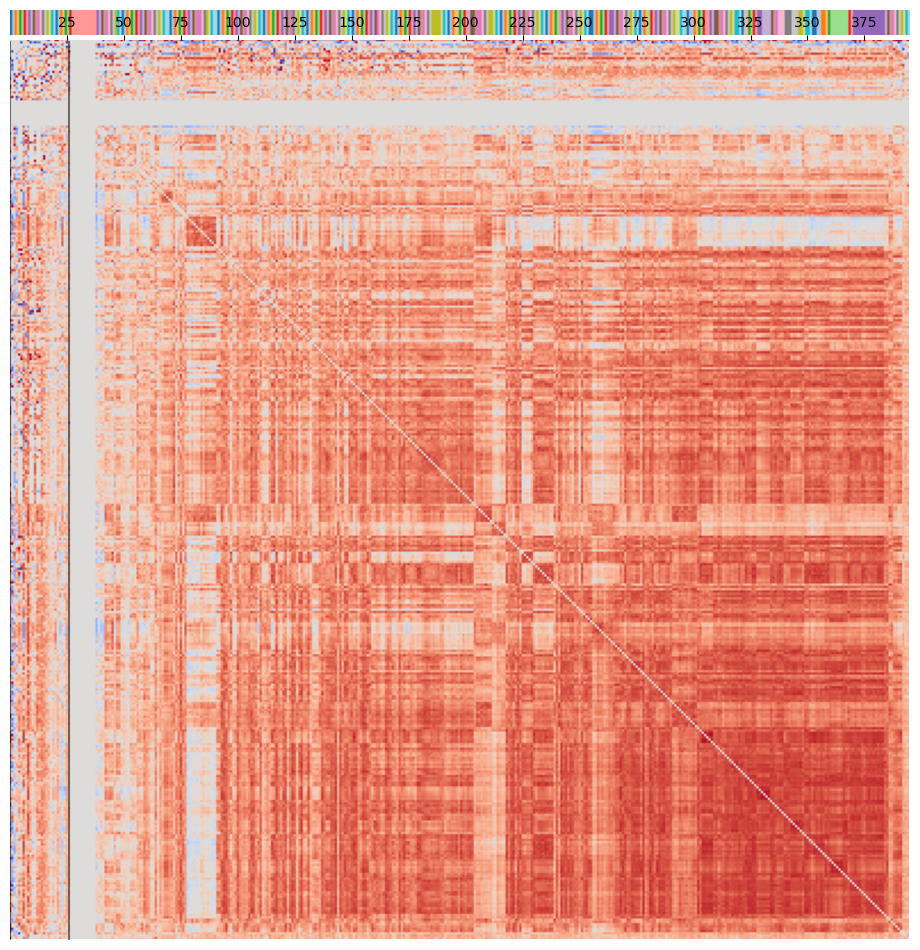

Cluster:: 332	KO: K02702  psaX; photosystem I 4.8kDa protein
Cluster:: 331	KO: K26113  lctD; lactate dehydrogenase (NAD+,ferredoxin) subunit LctD [EC:1.1.1.436]
Cluster:: 330	KO: K24112  asbE; petrobactin synthase [EC:2.-.-.-]
Cluster:: 329	KO: K14603  flnD2; 2'-carboxy-2,3-dihydroxybiphenyl 1,2-dioxygenase small subunit and ferredoxin fusion protein
Cluster:: 328	KO: K22962  NP7; nitrite dismutase [EC:1.7.6.1]
Cluster:: 327	KO: K00361  nasB; nitrite reductase [NAD(P)H] [EC:1.7.1.4]
Cluster:: 326	KO: K00534  E1.12.7.2S; ferredoxin hydrogenase small subunit [EC:1.12.7.2]
Cluster:: 325	KO: K10123  feoC; putative ferrous iron transport protein C
Cluster:: 324	KO: K04785  irp3, ybtU; yersiniabactin synthetase, thiazolinyl reductase component
Cluster:: 323	KO: K26139  nasD, nasB; nitrite reductase [NAD(P)H] large subunit [EC:1.7.1.4]
Cluster:: 322	KO: K26114  lctC; lactate dehydrogenase (NAD+,ferredoxin) subunit LctC
Cluster:: 321	KO: K04041  fbp3; fructose-1,6-bisphosphatase III [EC:3.1.3.

In [614]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [0,26]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

New cluster

In [ ]:
tselect=1.95

clusters = hierarchy.fcluster(lnk, tselect, criterion='distance')
clusters_sort = []
cl_sort_order = []
for idx in ko_order:
    cl = clusters[idx]
    clusters_sort.append(cl)
    if cl not in cl_sort_order:
        # Order of clusters
        cl_sort_order.append(cl)

# Rename so that cluster values are increasing when sorted
# This makes is to that tab20 separates better
dict_cl_new_cl = {cl:i+1 for i, cl in enumerate(cl_sort_order)}
clusters_sort_new = [dict_cl_new_cl[cl] for cl in clusters_sort]

# now make a new colormap
cmap_list = list(plt.get_cmap('tab20').colors)
factor = math.ceil(len(cl_sort_order) / 20)
cmap_list *= factor
cmap_list = cmap_list[:len(clusters_sort_new)]
cmap = pltc.ListedColormap(cmap_list)


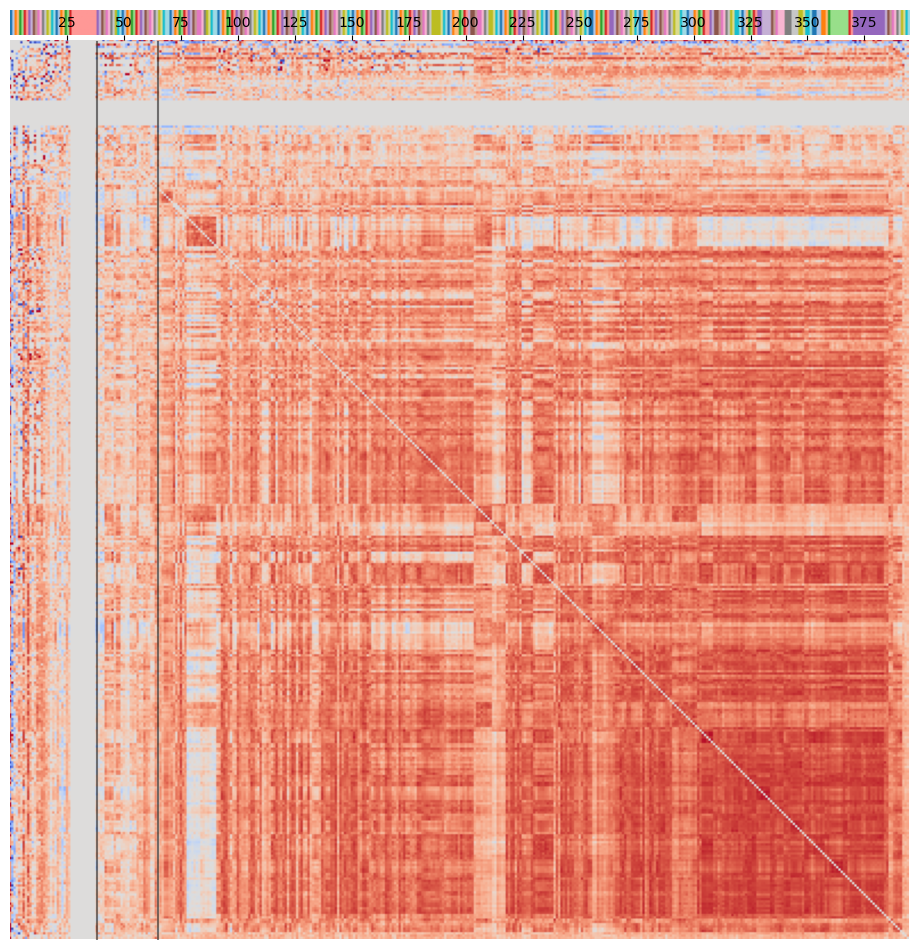

Cluster:: 307	KO: K00373  narJ, narW; nitrate reductase molybdenum cofactor assembly chaperone NarJ/NarW
Cluster:: 306	KO: K13255  fhuF; ferric iron reductase protein FhuF
Cluster:: 305	KO: K15876  nrfH; cytochrome c nitrite reductase small subunit
Cluster:: 304	KO: K11950  cmpA; bicarbonate transport system substrate-binding protein
Cluster:: 6	KO: K23306  brz; bacteriorhodopsin-regulating zinc finger protein
Cluster:: 4	KO: K04778  vibH; vibriobactin synthetase
Cluster:: 5	KO: K08940  pscA; photosystem P840 reaction center large subunit
Cluster:: 303	KO: K13857  SLC4A5, NBC4; solute carrier family 4 (sodium bicarbonate cotransporter), member 5
Cluster:: 302	KO: K02568  napB; nitrate reductase (cytochrome), electron transfer subunit
Cluster:: 7	KO: K02710  psbI; photosystem II PsbI protein
Cluster:: 8	KO: K21990  yfdC; formate-nitrite transporter family protein
Cluster:: 15	KO: K04758  feoA; ferrous iron transport protein A
Cluster:: 11	KO: K07674  narQ; two-component system, NarL fam

In [616]:
dims=(10,10)



clusters_plot = np.vstack([clusters_sort_new]*2)
fig = plt.figure(figsize=dims)
axs = {
    0: fig.add_axes([0.05, 0.955, 0.9, 0.025]),
    1: fig.add_axes([0.05, 0.05, 0.9, 0.9]),
}
axs[0].imshow(clusters_plot, cmap=cmap, aspect='auto')
axs[0].set_axis_off()
axs[1].imshow(arr_corr_stat_full_order, cmap='coolwarm', origin='upper')
axs[1].set_yticks([])
axs[1].set_xticks(np.arange(25, arr_corr_stat_full_order.shape[1],25))
# axs[1].invert_yaxis()
axs[1].xaxis.tick_top()
axs[1].set_ylim(arr_corr_stat_full_order.shape[0], 0)
axs[1].set_xlim(0,arr_corr_stat_full_order.shape[1])
for sp in axs[1].spines:
    axs[1].spines[sp].set_visible(False)


idxs = [38,65]
for idx in idxs:
    axs[1].plot([idx,idx],[1,arr_corr_stat_full_order.shape[0]], 'k', alpha=0.5)

plt.show()


# print([int(i) for i in clusters_sort[idxs[0]:idxs[-1]]])

for i in range(idxs[0],idxs[-1]+1):
    print(f'Cluster:: {clusters_sort[i]}\tKO: {dict_idx_koname[i]}')
    

## Show samples with upregulation in clusters

Subset table

```
Cluster:: 18	KO: K02695  psaH; photosystem I subunit VI
Cluster:: 18	KO: K02721  psbW; photosystem II PsbW protein
Cluster:: 18	KO: K03541  psbR; photosystem II 10kDa protein
Cluster:: 18	KO: K02701  psaN; photosystem I subunit PsaN
Cluster:: 18	KO: K14332  psaO; photosystem I subunit PsaO
```

In [643]:
ko_clust = [
    'K02695',
    'K02721',
    'K03541',
    'K02701',
    'K14332',
]
table_sub = table.iloc[:,:9]
table_sub = pd.concat([table_sub, table[ko_clust]], axis=1)
table_sub.shape, table_sub[:3]


((531, 14),
                                                fn_KO  \
 0  NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...   
 1  NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...   
 2  NPac.D1PA.diel.bf100.id99.aa.best.kofam.incT30...   
 
                   fn_sample_counts assembly sample ammendment timepoint depth  \
 0   D1PA.S06C1_C_600.abundance.tsv     D1PA  S06C1        NaN       600   NaN   
 1   D1PA.S15C1_C_200.abundance.tsv     D1PA  S15C1        NaN       200   NaN   
 2  D1PA.S34C1_C_2200.abundance.tsv     D1PA  S34C1        NaN      2200   NaN   
 
   size rep        K02695        K02721       K03541        K02701  \
 0  NaN   C  303278.57511  111691.39515  79005.00000  144144.96600   
 1  NaN   C  308596.43392   68950.00000  60250.67700  107250.44450   
 2  NaN   C  304007.41528   51694.96041  54823.64747   81871.57774   
 
          K14332  
 0  48090.000000  
 1  59100.000000  
 2  46851.151683  )

Sort samples by summed cluster

In [659]:
ko_clust_log = [ko + '_ln' for ko in ko_clust]

table_sub[ko_clust_log] = np.log(table_sub[ko_clust])
table_sub[:3]

table_sub['sum'] = np.ma.masked_invalid(table_sub[ko_clust_log]).sum(axis=1)

table_sub_sort = table_sub.sort_values(by='sum', ascending=True)
table_sub_sort[:3]

/opt/conda/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


,fn_KO,fn_sample_counts,assembly,sample,ammendment,timepoint,depth,size,rep,K02695,K02721,K03541,K02701,K14332,K02695_ln,K02721_ln,K03541_ln,K02701_ln,K14332_ln,sum
423,NPac.G3PA_PM.bf100.id99.aa.best.kofam.incT30.c...,G3.UW.PA.UW31_1.7m_PM.0.2um.BC.unstranded.abun...,G3.UW.PA,UW31,NaN,PM,1.7m,0.2um,BC,8619.746741,0.0,0.000000,3867.516365,0.000000,9.061811,-inf,-inf,8.260368,-inf,17.322179
446,NPac.G3PA_PM.bf100.id99.aa.best.kofam.incT30.c...,G3.UW.PA.UW36_1.7m_PM.0.2um.C.unstranded.abund...,G3.UW.PA,UW36,NaN,PM,1.7m,0.2um,C,0.000000,0.0,14430.346474,0.000000,48738.571911,-inf,-inf,9.577089,-inf,10.794226,20.371315
444,NPac.G3PA_PM.bf100.id99.aa.best.kofam.incT30.c...,G3.UW.PA.UW36_1.7m_PM.0.2um.A.unstranded.abund...,G3.UW.PA,UW36,NaN,PM,1.7m,0.2um,A,0.000000,0.0,0.000000,41934.967390,74376.217720,-inf,-inf,-inf,10.643875,11.216892,21.860767


Plot log normalized counts

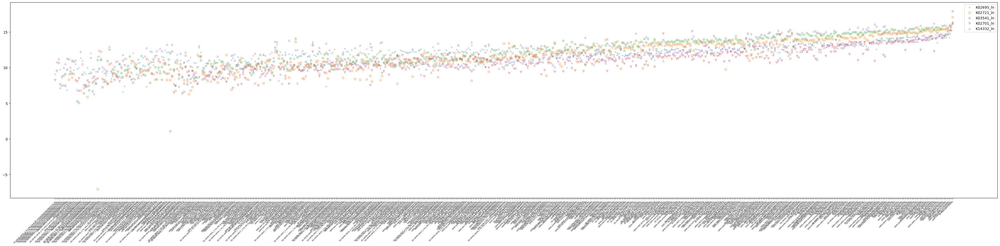

In [665]:
dims=(50,10)
ft=5
fig, ax = plt.subplots(figsize=dims)

markers = list(Line2D.markers.keys())
dict_ko_marker = dict(zip(ko_clust_log, markers))

colors = list(plt.get_cmap('tab10').colors)
dict_ko_color = dict(zip(ko_clust_log, colors))

x = np.arange(table_sub_sort.shape[0])

for ko in ko_clust_log:
    ax.scatter(
        x, table_sub_sort[ko].values, 
        color=dict_ko_color[ko], 
        marker=dict_ko_marker[ko],
        alpha=0.25,
        label=ko
    )

_ = ax.set_xticks(x)
_ = ax.set_xticklabels(table_sub_sort['fn_sample_counts'], rotation=45, size=ft, ha='right', rotation_mode='anchor')

ax.legend()

In [651]:
for m, func in Line2D.markers.items():
    print(m)

.
,
o
v
^
<
>
1
2
3
4
8
s
p
*
h
H
+
x
D
d
|
_
P
X
0
1
2
3
4
5
6
7
8
9
10
11
None
none
 

